Assessing current star galaxy performance by comparing with HST data in the COSMOS field.

In [1]:
import lsst.daf.persistence as dafPersist
import lsst.afw.display as afwDisplay
import lsst.afw.table as afwTable
import lsst.afw.geom as afwGeom
import os
from astropy.table import Table, hstack, vstack
import numpy as np
from copy import deepcopy
import sys
sys.path.insert(0,'/home/sr525/Python_Code')
import match_lists
import matplotlib.pyplot as plt

In [2]:
t_hst = Table.read("/home/nate2/shape_work/acs_clean_only.fits")
t_hsc = Table.read("/home/sr525/starGalaxy/HSC_COSMOS_clean.fits")
hsc_dir = "/datasets/hsc/repo/rerun/private/nate/shapeTest2/"
hsc_dir = "/datasets/hsc/repo/rerun/RC/w_2018_04/DM-13256/"
butler = dafPersist.Butler(inputs=hsc_dir)
t_info = Table.read("/home/sr525/starGalaxy/hscFeatures_class.fits")
t_test = Table.read("/home/sr525/starGalaxy/hscFeatures_test.fits")

In [3]:
dists, inds = match_lists.match_lists(t_info["RA"], t_info["DEC"], \
                                      t_info["RA"], t_info["DEC"], 1.5/3600.0, numNei=2)


ids = np.where((~np.isfinite(dists[:,1])))[0]

print(len(t_info))
t_info = t_info[ids]
print(len(t_info))

dists, inds = match_lists.match_lists(t_info["RA"], t_info["DEC"], \
                                      t_hst["ALPHAPEAK_J2000"], t_hst["DELTAPEAK_J2000"], 1.5/3600.0, numNei=2)

ids = np.where((~np.isfinite(dists[:,1])))[0]

t_info = t_info[ids]
print(len(t_info))


dists, inds = match_lists.match_lists(t_test["RA"], t_test["DEC"], \
                                      t_test["RA"], t_test["DEC"], 1.5/3600.0, numNei=2)


ids = np.where((~np.isfinite(dists[:,1])))[0]

print(len(t_test))
t_test = t_test[ids]
print(len(t_test))

dists, inds = match_lists.match_lists(t_test["RA"], t_test["DEC"], \
                                      t_hst["ALPHAPEAK_J2000"], t_hst["DELTAPEAK_J2000"], 1.5/3600.0, numNei=2)

ids = np.where((~np.isfinite(dists[:,1])))[0]

t_test = t_test[ids]
print(len(t_test))

#ids = np.where((t_info["R"] < 25))[0]
#t_info = t_info[ids]

#ids = np.where((t_test["R"] < 25))[0]
#t_test = t_test[ids]

417229
343136
263713
104308
99246
71888


In [4]:
stars = np.where((t_info["CLASS"] == 0))[0]
t_star = t_info[stars]
gals = np.where((t_info["CLASS"] == 1))[0]
t_gal = t_info[gals]

t_gal = t_gal[:len(t_star)*5]

t_info = vstack([t_star, t_gal])

In [5]:
def hst_hsc_im_comp(ras, decs, patches, t_hst, width):

    import make_cutout as mc
    import matplotlib.pyplot as plt
    import lsst.afw.coord as afwCoord
    import lsst.afw.geom as afwGeom
    from matplotlib.patches import Ellipse, PathPatch
    from astropy import wcs
    
    class_hst = t_hst["MU_CLASS"]
    
    for (j,(ra, dec, patch)) in enumerate(zip(ras, decs, patches)):
        
        t_hsc = Table.read("/home/sr525/starGalaxy/HSC_" + patch + ".fits")
        print("MAG_AUTO", t_hst["MAG_AUTO"][j], t_hst["MAGERR_AUTO"][j], \
              t_hst["MAG_AUTO"][j]/t_hst["MAGERR_AUTO"][j], "MU MAX", t_hst["MU_MAX"][j])
        print(t_hst["ELONGATION"][j])
        
        dataDetails = {"filter": "HSC-I", "tract": 9813, "patch": patch}
        exp = butler.get("deepCoadd_calexp", dataId=dataDetails)
        
        (_, vmin_hsc, vmax_hsc, im_hsc, ids_hsc, cs_hsc) = mc.make_cutout_lsst(ra, dec, \
                                                                      exp, width=width, \
                                                                      w_units="arcsecs")
    
        [(hdulist, vmin_hst, vmax_hst)] = mc.cutout_HST(ra, dec, width=width, \
                                                        return_data=True)
        [(hdulist1, vmin_hst1, vmax_hst1)] = mc.cutout_HST(ra, dec, width=width/2.0, \
                                                        return_data=True)
    
        im_hst = hdulist[1].data
        im_hst1 = hdulist1[1].data
    
        fig, ax_arr = plt.subplots(ncols=3, figsize=(8,3))
        ax_arr[0].imshow(im_hsc, vmin = vmin_hsc, vmax = vmax_hsc, cmap = "gray_r")
        ax_arr[1].imshow(im_hst, vmin = vmin_hst, vmax = vmax_hst, cmap = "gray_r")
        ax_arr[2].imshow(im_hst1, vmin = vmin_hst1*2, vmax = vmax_hst1*2, \
                         cmap = "gray_r")
   
        wcs_hsc = exp.getWcs()
        bbox_hsc = exp.getBBox()
        xoffset_hsc = bbox_hsc.getBeginX()
        yoffset_hsc = bbox_hsc.getBeginY()  
        
        w = wcs.WCS(hdulist[1].header, naxis = 2)
        w1 = wcs.WCS(hdulist1[1].header, naxis = 2)
        
        dists, inds = match_lists.match_lists([ra], [dec], t_hst["ALPHAPEAK_J2000"], \
                                             t_hst["DELTAPEAK_J2000"], \
                                             20.0/3600.0, numNei=200)
        #print dist, inds
        dists = dists[0]
        inds = inds[0]
        
        print("HST CLASS:", class_hst[inds[0]])

        for (ind, dist) in zip(inds, dists):
            if ind != len(t_hst):
                
                ra_plot = t_hst["ALPHAPEAK_J2000"][ind]
                dec_plot = t_hst["DELTAPEAK_J2000"][ind]
                
                k = t_hst["KRON_RADIUS"][ind]
                if k == 0:
                    #print(dist, "No Kron")
                    k = 5
                h_im = t_hst["A_IMAGE"][ind]
                w_im = t_hst["B_IMAGE"][ind]
                t_im = t_hst["THETA_IMAGE"][ind]
                
                coord = afwCoord.Coord(afwGeom.Point2D(ra_plot, dec_plot), afwGeom.degrees)
                pix = wcs_hsc.skyToPixel(coord)
                x = pix[0]-xoffset_hsc-ids_hsc[1]+cs_hsc[2]
                y = pix[1]-yoffset_hsc-ids_hsc[3]+cs_hsc[0]
               
                circ_other = Ellipse(xy = (x,y), width=w_im, height=h_im, angle=t_im, \
                                     fill = False, color = "red", lw = 2)
                ax_arr[0].add_patch(circ_other)
                
                xy = w.wcs_world2pix(np.array([[ra_plot, dec_plot]], np.float_), 1)
                xy = (xy[0][0], xy[0][1])
                circ = Ellipse(xy = xy, width=w_im*k, height=h_im*k, angle=t_im, \
                               fill = False, color = "red", lw = 2)
                ax_arr[1].add_patch(circ)
                
                xy1 = w1.wcs_world2pix(np.array([[ra_plot, dec_plot]], np.float_), 1)
                xy1 = (xy1[0][0], xy1[0][1])
                circ1 = Ellipse(xy = xy1, width=w_im*k, height=h_im*k, angle=t_im, \
                               fill = False, color = "red", lw = 2)
                ax_arr[2].add_patch(circ1)
                
        
        dist, inds = match_lists.match_lists([ra], [dec], np.rad2deg(t_hsc["coord_ra_I"]), \
                                             np.rad2deg(t_hsc["coord_dec_I"]), \
                                             100.0/3600.0, numNei=200)
        dist = dist[0]
        inds = inds[0]
        xx = t_hsc["modelfit_CModel_ellipse_xx_I"][inds[0]]
        yy = t_hsc["modelfit_CModel_ellipse_yy_I"][inds[0]]
        xy = t_hsc["modelfit_CModel_ellipse_xy_I"][inds[0]]
        mat = [[xx,xy],[xy,yy]]
        mod_seeing = (xx*yy - xy*xy)**0.25
                
        xx_se = t_hsc["base_SdssShape_psf_xx_I"][inds[0]]
        xy_se = t_hsc["base_SdssShape_psf_xy_I"][inds[0]]
        yy_se = t_hsc["base_SdssShape_psf_yy_I"][inds[0]]
        seeing = (xx_se*yy_se - xy_se*xy_se)**0.25
        #print(t_hsc["modelfit_CModel_flag_I"][inds][0])
        
        #print(t_hsc["base_PsfFlux_flag_edge_I"][inds[0]])
        #print(t_hsc["base_PixelFlags_flag_edge_I"][inds[0]])
        #print("HSC CLASS:", class_hsc[inds[0]])
        for ind in inds:
            if ind != len(t_hsc):
                
                ra_plot = np.rad2deg(t_hsc["coord_ra_I"][ind])
                dec_plot = np.rad2deg(t_hsc["coord_dec_I"][ind])
                coord = afwCoord.Coord(afwGeom.Point2D(ra_plot, dec_plot), afwGeom.degrees)
                pix = wcs_hsc.skyToPixel(coord)
                x = pix[0]-xoffset_hsc-ids_hsc[1]+cs_hsc[2]
                y = pix[1]-yoffset_hsc-ids_hsc[3]+cs_hsc[0]
                
                k = t_hsc["ext_photometryKron_KronFlux_psf_radius_I"][ind]
                xx = t_hsc["modelfit_CModel_ellipse_xx_I"][ind]
                yy = t_hsc["modelfit_CModel_ellipse_yy_I"][ind]
                xy = t_hsc["modelfit_CModel_ellipse_xy_I"][ind]
               
                xx_se = t_hsc["base_SdssShape_psf_xx_I"][ind]
                xy_se = t_hsc["base_SdssShape_psf_xy_I"][ind]
                yy_se = t_hsc["base_SdssShape_psf_yy_I"][ind]
                seeing = (xx_se*yy_se - xy_se*xy_se)**0.25
                mat = [[xx+xx_se,xy+xy_se],[xy+xy_se,yy+yy_se]]
                mod_seeing = (xx*yy - xy*xy)**0.25
 
                try:
                    lam, v = np.linalg.eig(mat)
                except Exception as e:
                    lam = (1,1)
                    v = np.array([[1,1],[1,1]])
                lam = np.sqrt(lam)
                
                circ_other = Ellipse(xy = (x,y), width = lam[0]*seeing, \
                                     height = lam[1]*seeing, angle=np.arccos(v[0,0]), \
                                     fill=False, color="blue", lw = 1)
                ax_arr[0].add_patch(circ_other)
        
                xy = w.wcs_world2pix(np.array([[ra_plot, dec_plot]], np.float_), 1)
                xy = (xy[0][0], xy[0][1])
                circ = Ellipse(xy = xy, width=lam[0]*11.56*k, height=lam[1]*11.56*k, \
                               angle=np.arccos(v[0,0]), \
                               fill = False, color = "blue", lw = 1)
                ax_arr[1].add_patch(circ)
                
                xy1 = w1.wcs_world2pix(np.array([[ra_plot, dec_plot]], np.float_), 1)
                xy1 = (xy1[0][0], xy1[0][1])
                circ1 = Ellipse(xy = xy1, width=lam[0]*11.56, height=lam[1]*11.56, \
                                angle=np.arccos(v[0,0]), \
                                fill = False, color = "blue", lw = 1)
                ax_arr[2].add_patch(circ1)
                

        for ax in ax_arr:
            for i in iter(ax.spines.values()):
                i.set_linewidth(3.0)
        
            ax.axes.get_xaxis().set_visible(False)
            ax.axes.get_yaxis().set_visible(False)
        
        if j == 0:
            ax_arr[0].set_title("HSC")
            ax_arr[1].set_title("HST")
            ax_arr[2].set_title("HST Zoom")
            title = "HSC and HST comparison"
            plt.suptitle(title)
        
        for i in iter(ax_arr[0].spines.values()):
            i.set_color("blue")
        for i in iter(ax_arr[1].spines.values()):
            i.set_color("red")
        plt.show()

In [6]:
#ids = np.where((t_info["Z"] < 27.0))[0]

#t_info = t_info[ids]

#print(len(t_info))


In [7]:
def mad(xs, med):
    
    return np.median(np.fabs(xs-med))

In [8]:
from sklearn.preprocessing import PowerTransformer, minmax_scale

cols_to_use = ["G", "R", "I", "Z", "Y", "GR", "RI", "IZ", "ZY", "G_PM", "R_PM", "I_PM", \
               "Z_PM", "Y_PM", "M", "B"]
#cols_to_use = ["R", "I", "Z", "GR", "RI", "IZ", "ZY", "R_PM", "I_PM", "Z_PM", \
#               "M", "B"]
#cols_to_use = ["MAG", "G_PM", "R_PM", "I_PM", "Z_PM", "Y_PM"]
features = np.zeros((len(cols_to_use), len(t_info)))
scales = np.zeros((len(cols_to_use), 2))

for (i, col) in enumerate(cols_to_use):
    xs = t_info[col].data
    if np.min(xs) < 0:
        xs = xs + -1.0*np.min(xs) + 1
    pt = PowerTransformer(method='box-cox', standardize=True)
    xs_trans = pt.fit_transform(xs.reshape(-1,1))
    features[i] = xs_trans.reshape(1,-1)
    

In [9]:
from sklearn import svm
from sklearn.preprocessing import PowerTransformer, minmax_scale
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

from sklearn.datasets import make_gaussian_quantiles

input_class = t_info["CLASS"].data

clf  = AdaBoostClassifier(DecisionTreeClassifier(max_depth=2), n_estimators=400, \
                              learning_rate=1)


clf.fit(features.T, input_class)

print(clf)

AdaBoostClassifier(algorithm='SAMME.R',
          base_estimator=DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=2,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best'),
          learning_rate=1, n_estimators=400, random_state=None)


In [10]:
from sklearn.calibration import CalibratedClassifierCV

clf_isotonic = CalibratedClassifierCV(clf, cv=2, method='isotonic')
clf_isotonic.fit(features.T, input_class, None)

probs_raw = clf.predict_proba(features.T)
predictions_raw = clf.predict(features.T)

In [11]:
from sklearn.preprocessing import PowerTransformer, minmax_scale

cols_to_use = ["G", "R", "I", "Z", "Y", "GR", "RI", "IZ", "ZY", "G_PM", "R_PM", "I_PM", \
               "Z_PM", "Y_PM", "M", "B"]
#cols_to_use = ["R", "I", "Z", "GR", "RI", "IZ", "ZY", "R_PM", "I_PM", "Z_PM", \
#               "M", "B"]
#cols_to_use = ["G", "R", "I", "Z", "Y", "G_PM", "R_PM", "I_PM", "Z_PM", "Y_PM", \
#               "M", "B"]
#cols_to_use = ["MAG", "G_PM", "R_PM", "I_PM", "Z_PM", "Y_PM"]
features = np.zeros((len(cols_to_use), len(t_test)))
scales = np.zeros((len(cols_to_use), 2))

for (i, col) in enumerate(cols_to_use):
    xs = t_test[col].data
    if np.min(xs) < 0:
        xs = xs + -1.0*np.min(xs) + 1
    pt = PowerTransformer(method='box-cox', standardize=True)
    xs_trans = pt.fit_transform(xs.reshape(-1,1))
    features[i] = xs_trans.reshape(1,-1)
    

In [12]:
probs = clf_isotonic.predict_proba(features.T)
predictions = clf_isotonic.predict(features.T)

In [13]:
def broken_axis_plot(xs, ys, thresh, xlabel, ylabel, vline=[], hline=[], col="b"):
    
    ids = np.where((ys > thresh))[0]
    ids2 = np.where((ys < thresh))[0]

    d = .015
    fig, (ax, ax2) = plt.subplots(2, 1, sharex=True)

    ax.plot(xs[ids], ys[ids], ".", color=col)
    
    ax.set_xlim(17, 29)
    ax.spines['bottom'].set_visible(False)
    ax.xaxis.tick_top()
    ax.tick_params(labeltop='off')
    ylims = ax.get_ylim()
    
    ax2.plot(xs[ids2], ys[ids2], ".", color=col)
    ax2.set_xlabel(xlabel)
    
    ax2.spines['top'].set_visible(False)
    ax2.xaxis.tick_bottom()
    ax2.set_ylim(-0.01, 0.05)
 
    axis_to_data = ax.transAxes + ax.transData.inverted()
    data_to_axis = axis_to_data.inverted()

    for x in vline:
        ax.axvline(x, ls=":", color="k")
        ax2.axvline(x, ls=":", color="k")
        x_ax = data_to_axis.transform((x,0))[0]
        kwargs = dict(transform=ax.transAxes, color='k', clip_on=False)
        ax.plot((-d+x_ax, +d+x_ax), (-d, +d), **kwargs)
        kwargs.update(transform=ax2.transAxes)  # switch to the bottom axes
        ax2.plot((-d+x_ax, +d+x_ax), (1 - d, 1 + d), **kwargs)
        
    for y in hline:
        if y > thresh:
            ax.axhline(y, ls=":", color="k")
        if y < thresh:
            ax2.axhline(y, ls=":", color="k") 
    
    kwargs = dict(transform=ax.transAxes, color='k', clip_on=False)
    ax.plot((-d, +d), (-d, +d), **kwargs)        # top-left diagonal
    ax.plot((1 - d, 1 + d), (-d, +d), **kwargs)  # top-right diagonal

    kwargs.update(transform=ax2.transAxes)  # switch to the bottom axes
    ax2.plot((-d, +d), (1 - d, 1 + d), **kwargs)  # bottom-left diagonal
    ax2.plot((1 - d, 1 + d), (1 - d, 1 + d), **kwargs)  # bottom-right diagonal  

    
    ax2.text(-0.15, 2.1, ylabel, transform=ax2.transAxes, rotation=90)
    plt.show()

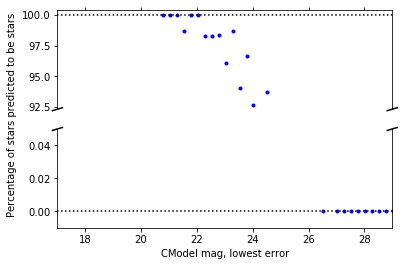

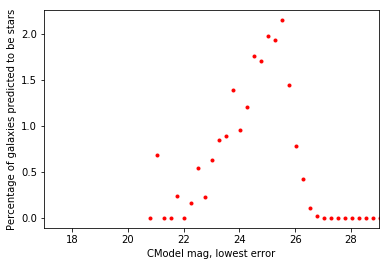

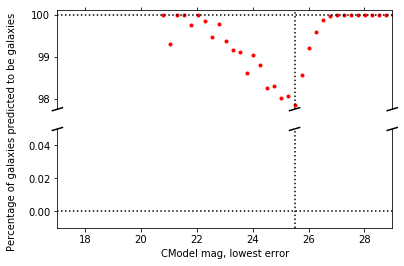

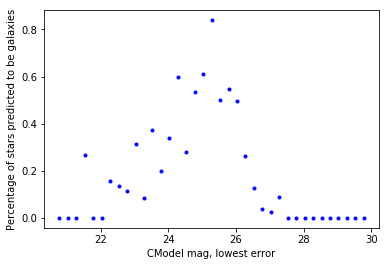

In [14]:
import matplotlib.pyplot as plt

xs = t_test["MAG"]
ys = []

sep_prob = 0.8

xs = np.arange(np.min(t_test["MAG"])+4.0, np.max(t_test["MAG"]), 0.25)
for (i, mag) in enumerate(xs[1:]):
    ids = np.where((t_test["CLASS"] == 0) & (probs[:,0] > sep_prob) & \
                   (t_test["MAG"] < mag) & (t_test["MAG"] > xs[i]))[0]
    num = np.where((t_test["MAG"] < mag) & (t_test["CLASS"] == 0) & \
                   (t_test["MAG"] > xs[i]))[0]
    try:
        ys.append(len(ids)/len(num)*100)
    except ZeroDivisionError:
        ys.append(0)

ys = np.array(ys)
xlabel = "CModel mag, lowest error"
ylabel = "Percentage of stars predicted to be stars"
broken_axis_plot(xs[1:], ys, 90, xlabel, ylabel, hline=[0, 100])

ys = []
xs = np.arange(np.min(t_test["MAG"])+4.0, np.max(t_test["MAG"]), 0.25)
for (i, mag) in enumerate(xs[1:]):
    ids = np.where((t_test["CLASS"] == 1) & (probs[:,0] > sep_prob) & \
                   (t_test["MAG"] < mag) & (t_test["MAG"] > xs[i]))[0]
    num = np.where((t_test["MAG"] < mag) & (t_test["CLASS"] == 1) & \
                   (t_test["MAG"] > xs[i]))[0]
    try:
        ys.append(len(ids)/len(num)*100)
    except ZeroDivisionError:
        ys.append(0)
    
plt.plot(xs[1:], ys, "r.")
plt.ylabel("Percentage of galaxies predicted to be stars")
plt.xlabel("CModel mag, lowest error")
plt.xlim(17, 29)
plt.show()

ys = []
xs = np.arange(np.min(t_test["MAG"])+4.0, np.max(t_test["MAG"]), 0.25)
for (i, mag) in enumerate(xs[1:]):
    ids = np.where((t_test["CLASS"] == 1) & (probs[:,0] < sep_prob) & \
                   (t_test["MAG"] < mag) & (t_test["MAG"] > xs[i]))[0]
    num = np.where((t_test["MAG"] < mag) & (t_test["CLASS"] == 1) & \
                   (t_test["MAG"] > xs[i]))[0]
    try:
        ys.append(len(ids)/len(num)*100)
    except ZeroDivisionError:
        ys.append(0)

ys = np.array(ys)
xlabel = "CModel mag, lowest error"
ylabel = "Percentage of galaxies predicted to be galaxies"
broken_axis_plot(xs[1:], ys, 90, xlabel, ylabel, hline=[0, 100], vline=[25.5], col="r")
        
ys = []
xs = np.arange(np.min(t_test["MAG"])+4.0, np.max(t_test["MAG"]), 0.25)
for (i, mag) in enumerate(xs[1:]):
    ids = np.where((t_test["CLASS"] == 0) & (probs[:,0] < sep_prob) & \
                   (t_test["MAG"] < mag) & (t_test["MAG"] > xs[i]))[0]
    num = np.where((t_test["MAG"] < mag) & (t_test["CLASS"] == 1) & \
                   (t_test["MAG"] > xs[i]))[0]
    try:
        ys.append(len(ids)/len(num)*100)
    except ZeroDivisionError:
        ys.append(0)

plt.plot(xs[1:], ys, "b.")
plt.ylabel("Percentage of stars predicted to be galaxies")
plt.xlabel("CModel mag, lowest error")
plt.show()

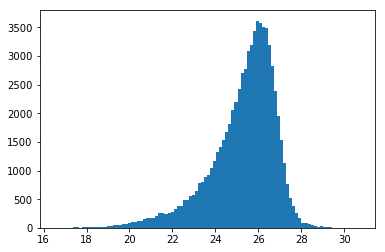

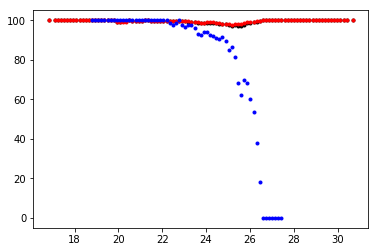

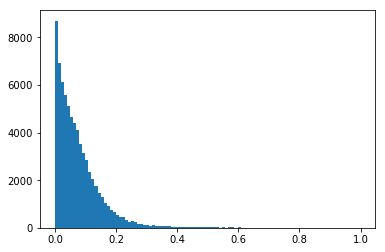

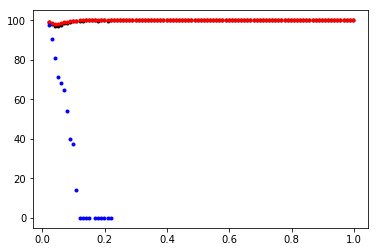

In [15]:
predictions = np.zeros(len(t_test))
predictions[probs[:,0] < sep_prob] = 1.0

n, bins, patches = plt.hist(t_test["I"], bins = 100)
plt.show()
i = 0
perc_rights = []
perc_right_stars = []
perc_right_gals = []

while i < len(bins)-1:
    ids = np.where((t_test["I"] < bins[i+1]) & (t_test["I"] > bins[i-1]))[0]
    right = np.where((predictions[ids] == t_test["CLASS"][ids]))[0]
    try:
        perc_right = len(right)/len(ids)*100
    except ZeroDivisionError:
        perc_right = np.NaN
    perc_rights.append(perc_right)
    ids = np.where((t_test["I"] < bins[i+1]) & (t_test["I"] > bins[i-1]) & \
                   (t_test["CLASS"] == 0))[0]
    right = np.where((predictions[ids] == t_test["CLASS"][ids]))[0]
    try:
        perc_right = len(right)/len(ids)*100
    except ZeroDivisionError:
        perc_right = np.NaN
    perc_right_stars.append(perc_right)
    ids = np.where((t_test["I"] < bins[i+1]) & (t_test["I"] > bins[i-1]) & \
                   (t_test["CLASS"] == 1))[0]
    right = np.where((predictions[ids] == t_test["CLASS"][ids]))[0]
    try:
        perc_right = len(right)/len(ids)*100
    except ZeroDivisionError:
        perc_right = np.NaN
    perc_right_gals.append(perc_right)
 
    i += 1
    
plt.plot(bins[1:], perc_rights, "k.")
plt.plot(bins[1:], perc_right_gals, "r.")
plt.plot(bins[1:], perc_right_stars, "b.")

plt.show()

ids = np.where((t_test["I_ERR"] < 1.0))[0]
n, bins, patches = plt.hist(t_test["I_ERR"][ids], bins = 100)
plt.show()
i = 0
perc_rights = []
perc_right_stars = []
perc_right_gals = []

while i < len(bins)-1:
    ids = np.where((t_test["I_ERR"] < bins[i+1]) & (t_test["I_ERR"] > bins[i-1]))[0]
    right = np.where((predictions[ids] == t_test["CLASS"][ids]))[0]
    try:
        perc_right = len(right)/len(ids)*100
    except ZeroDivisionError:
        perc_right = np.NaN
    perc_rights.append(perc_right)
    ids = np.where((t_test["I_ERR"] < bins[i+1]) & (t_test["I_ERR"] > bins[i-1]) & \
                   (t_test["CLASS"] == 0))[0]
    right = np.where((predictions[ids] == t_test["CLASS"][ids]))[0]
    try:
        perc_right = len(right)/len(ids)*100
    except ZeroDivisionError:
        perc_right = np.NaN
    perc_right_stars.append(perc_right)
    ids = np.where((t_test["I_ERR"] < bins[i+1]) & (t_test["I_ERR"] > bins[i-1]) & \
                   (t_test["CLASS"] == 1))[0]
    right = np.where((predictions[ids] == t_test["CLASS"][ids]))[0]
    try:
        perc_right = len(right)/len(ids)*100
    except ZeroDivisionError:
        perc_right = np.NaN
    perc_right_gals.append(perc_right)
 
    i += 1
    
plt.plot(bins[1:], perc_rights, "k.")
plt.plot(bins[1:], perc_right_gals, "r.")
plt.plot(bins[1:], perc_right_stars, "b.")

plt.show()

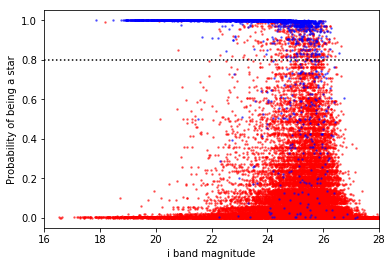

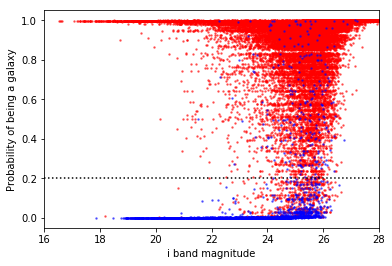

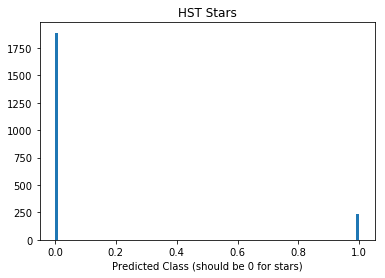

234


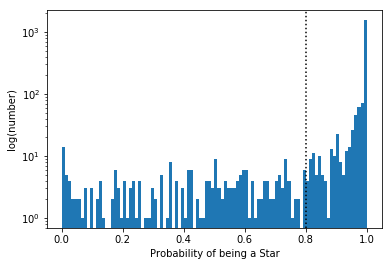

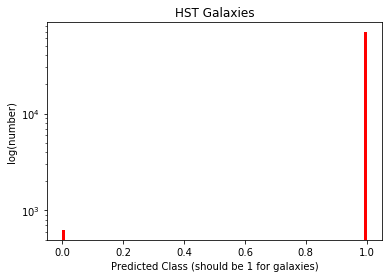

630


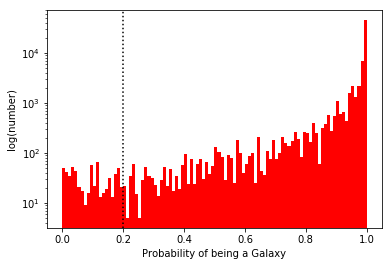

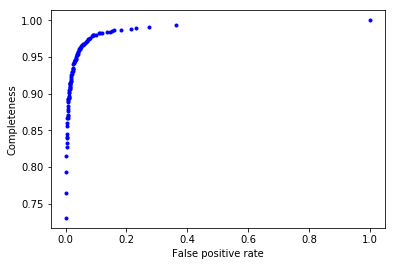

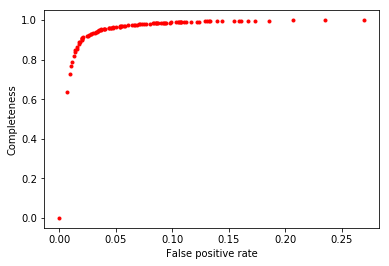

In [16]:
star = np.where((t_test["CLASS"] == 0))[0]
gal = np.where((t_test["CLASS"] == 1))[0]

predictions = np.zeros(len(t_test))
predictions[probs[:,0] < sep_prob] = 1.0

plt.plot(t_test["MAG"][gal], probs[:,0][gal], "r.", ms=3, alpha=0.5)
plt.plot(t_test["MAG"][star], probs[:,0][star], "b.", ms=3, alpha=0.5)
plt.xlim(16.0, 28.0)
plt.axhline(sep_prob, color="k", ls=":")
plt.xlabel("i band magnitude")
plt.ylabel("Probability of being a star")
plt.show()

plt.plot(t_test["MAG"][gal], probs[:,1][gal], "r.", ms=3, alpha=0.5)
plt.plot(t_test["MAG"][star], probs[:,1][star], "b.", ms=3, alpha=0.5)
plt.xlim(16.0, 28.0)
plt.xlabel("i band magnitude")
plt.axhline(1-sep_prob, color="k", ls=":")
plt.ylabel("Probability of being a galaxy")
plt.show()
plt.hist(predictions[star], bins=100)
plt.title("HST Stars")
plt.xlabel("Predicted Class (should be 0 for stars)")
plt.show()

print(len(np.where((predictions[star] == 1))[0]))

plt.hist(probs[:,0][star], bins=100)
plt.axvline(sep_prob, color="k", ls=":")
plt.xlabel("Probability of being a Star")
plt.yscale("log")
plt.ylabel("log(number)")
plt.show()

plt.hist(predictions[gal], bins=100, color="r")
plt.title("HST Galaxies")
plt.xlabel("Predicted Class (should be 1 for galaxies)")
plt.yscale("log")
plt.ylabel("log(number)")
plt.show()

print(len(np.where((predictions[gal] == 0))[0]))

plt.hist(probs[:,1][gal], bins=100, color="r")
plt.xlabel("Probability of being a Galaxy")
plt.yscale("log")
plt.ylabel("log(number)")
plt.axvline(1-sep_prob, color="k", ls=":")
plt.show()

xs = []
ys = []
for thresh in np.arange(0.0, 1.0, 0.01):
    false_positive = np.where((t_test["CLASS"] == 1) & (probs[:,0] > thresh))[0]
    true_positive = np.where((t_test["CLASS"] == 0) & (probs[:,0] > thresh))[0]
    false_negatives = np.where((t_test["CLASS"] == 0) & (probs[:,1] > (1-thresh)))[0]
    true_negative = np.where((t_test["CLASS"] == 1) & (probs[:,1] > (1-thresh)))[0]
    
    try:
        xs.append(len(false_positive)/(len(false_positive) + len(true_negative)))
    except ZeroDivisionError:
        xs.append(0.0)
    try:
        ys.append(len(true_positive)/(len(false_negatives) + len(true_positive)))
    except ZeroDivisionError:
        ys.append(0.0)

plt.plot(xs, ys, "b.")
plt.xlabel("False positive rate")
plt.ylabel("Completeness")
plt.show()

xs = []
ys = []
for thresh in np.arange(0.0, 1.0, 0.01):
    false_positive = np.where((t_test["CLASS"] == 0) & (probs[:,0] < thresh))[0]
    true_positive = np.where((t_test["CLASS"] == 1) & (probs[:,0] < thresh))[0]
    false_negatives = np.where((t_test["CLASS"] == 1) & (probs[:,0] > (thresh)))[0]
    true_negative = np.where((t_test["CLASS"] == 0) & (probs[:,0] > (thresh)))[0]
    
    try:
        xs.append(len(false_positive)/(len(false_positive) + len(true_negative)))
    except ZeroDivisionError:
        xs.append(0.0)
    try:
        ys.append(len(true_positive)/(len(false_negatives) + len(true_positive)))
    except ZeroDivisionError:
        ys.append(0.0)

plt.plot(xs, ys, "r.")
plt.xlabel("False positive rate")
plt.ylabel("Completeness")
plt.show()

HST stars classified incorrectly: 234 out of 2123 ~ 11.0%
HST galaxies classified incorrectly: 630 out of 69765 ~ 0.9%


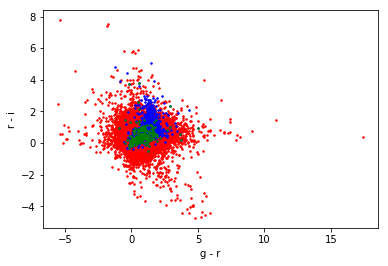

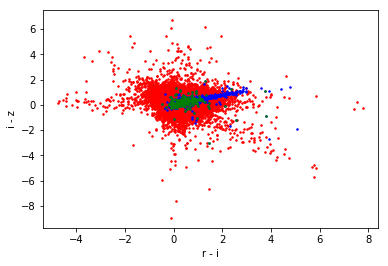

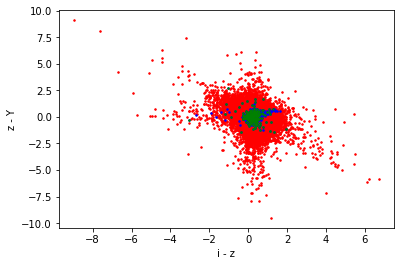

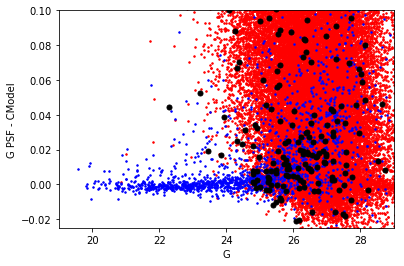

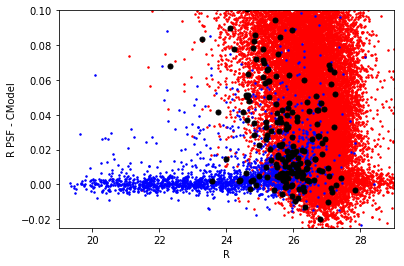

...

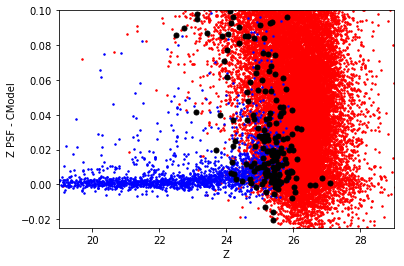

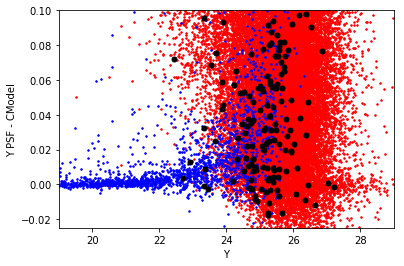

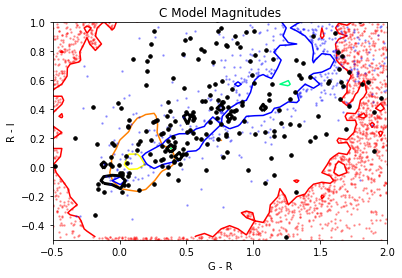

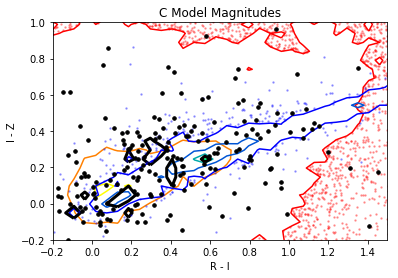

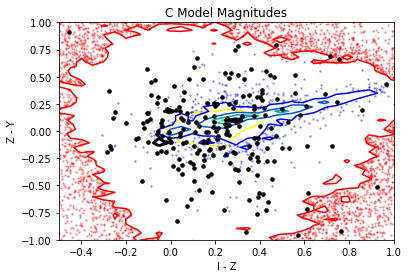

In [17]:
wrong_stars = np.where((probs[:,0] < sep_prob) & (t_test["CLASS"] == 0))[0]
print("HST stars classified incorrectly:", len(wrong_stars), "out of", len(star), \
      "~ {0:.1f}%".format(len(wrong_stars)/len(star)*100))

wrong_gals = np.where((probs[:,0] > (sep_prob)) & (t_test["CLASS"] == 1))[0]
print("HST galaxies classified incorrectly:", len(wrong_gals), "out of", len(gal), \
     "~ {0:.1f}%".format(len(wrong_gals)/len(gal)*100))

#for col in t_test.columns[2:]:
#    plt.hist(t_test[col][gal], bins = 1000, color="r")
#    plt.hist(t_test[col][star], bins = 1000, color="b")
#    plt.hist(t_test[col][wrong_stars], bins = 1000, color="g")
#    plt.xlabel(col)
#    plt.show()

plt.plot(t_test["GR"][gal], t_test["RI"][gal], "r.", ms=3)
plt.plot(t_test["GR"][star], t_test["RI"][star], "b.", ms=3)
plt.plot(t_test["GR"][wrong_stars], t_test["RI"][wrong_stars], "g.", ms=3)
plt.xlabel("g - r")
plt.ylabel("r - i")
plt.show()

plt.plot(t_test["RI"][gal], t_test["IZ"][gal], "r.", ms=3)
plt.plot(t_test["RI"][star], t_test["IZ"][star], "b.", ms=3)
plt.plot(t_test["RI"][wrong_stars], t_test["IZ"][wrong_stars], "g.", ms=3)
plt.xlabel("r - i")
plt.ylabel("i - z")
plt.show()

plt.plot(t_test["IZ"][gal], t_test["ZY"][gal], "r.", ms=3)
plt.plot(t_test["IZ"][star], t_test["ZY"][star], "b.", ms=3)
plt.plot(t_test["IZ"][wrong_stars], t_test["ZY"][wrong_stars], "g.", ms=3)
plt.xlabel("i - z")
plt.ylabel("z - Y")
plt.show()

for band in ["G", "R", "I", "Z", "Y"]:
    plt.plot(t_test[band][gal], t_test[band + "_PM"][gal], "r.", ms=3)
    plt.plot(t_test[band][star], t_test[band + "_PM"][star], "b.", ms=3)
    plt.plot(t_test[band][wrong_stars], t_test[band + "_PM"][wrong_stars], "k.", ms=10)
    plt.ylim(-0.025, 0.1)
    plt.xlim(19, 29)
    plt.xlabel(band)
    plt.ylabel(band + " PSF - CModel")
    plt.show()

    
magCol = "magPsf_"
magModCol = "magModel_"
magPsfCol = "magPsf_"

xlims = [(-0.5,2), (-0.2,1.5), (-0.5,1.0)]
ylims = [(-0.5,1), (-0.2,1.0), (-1.0,1.0)]

i = 0
bands = ["GR", "RI", "IZ", "ZY"]
while i < len(bands)-1:
    
    xs_s = t_test[bands[i]][star]
    ys_s = t_test[bands[i+1]][star]
    xs_e = t_test[bands[i]][gal]
    ys_e = t_test[bands[i+1]][gal]
    xs_w = t_test[bands[i]][wrong_stars]
    ys_w = t_test[bands[i+1]][wrong_stars]
   
    counts_s, xbins_s, ybins_s, im = plt.hist2d(xs_s, ys_s, bins=100)
    counts_e, xbins_e, ybins_e, im = plt.hist2d(xs_e, ys_e, bins=(xbins_s, ybins_s))
    counts_w, xbins_w, ybins_w, im = plt.hist2d(xs_w, ys_w, bins=(xbins_s, ybins_s))
    plt.close()
    levels = np.arange(np.min(counts_e[counts_e > 0])*10, np.max(counts_e), 200)
    x = xbins_e[:-1]
    y = ybins_e[:-1]
    z = counts_e.T
    levels_e = plt.contour(x, y, z, cmap=plt.cm.autumn, levels=levels)
    paths_e = levels_e.collections[0].get_paths()
    inside = paths_e[0].contains_points(np.array([xs_e, ys_e]).T)
    for path_e in paths_e[1:]:
        inside_new = path_e.contains_points(np.array([xs_e, ys_e]).T)
        inside = inside | inside_new
    plt.plot(xs_e[~inside], ys_e[~inside], "r.", ms=3, alpha=0.3, mfc="r", zorder=-1)
        
    levels = np.arange(np.min(counts_s[counts_s > 0])*5, np.max(counts_s), 20)
    x = xbins_s[:-1]
    y = ybins_s[:-1]
    z = counts_s.T
    levels_s = plt.contour(x, y, z, cmap=plt.cm.winter, levels = levels)
    paths_s = levels_s.collections[0].get_paths()
    inside = paths_s[0].contains_points(np.array([xs_s, ys_s]).T)
    for path_s in paths_s[1:]:
        inside_new = path_s.contains_points(np.array([xs_s, ys_s]).T)
        inside = inside | inside_new
    plt.plot(xs_s[~inside], ys_s[~inside], "b.", ms=3, alpha=0.3)
    
    levels = np.arange(np.min(counts_w[counts_w > 0])*2, np.max(counts_w), 5)
    x = xbins_w[:-1]
    y = ybins_w[:-1]
    z = counts_w.T
    try:
        levels_w = plt.contour(x, y, z, colors="k", levels=levels, linewidths=3)
        paths_w = levels_w.collections[0].get_paths()
        inside = paths_w[0].contains_points(np.array([xs_w, ys_w]).T)
        for path_w in paths_w[1:]:
            inside_new = path_w.contains_points(np.array([xs_w, ys_w]).T)
            inside = inside | inside_new
        plt.plot(xs_w[~inside], ys_w[~inside], "k.", ms=7)
    except ValueError:
        plt.plot(xs_w, ys_w, "k.", ms=7)
    
    
    plt.title("C Model Magnitudes")
    plt.xlim(xlims[i])
    plt.ylim(ylims[i])
    plt.xlabel(bands[i][0] + " - " + bands[i][1])
    plt.ylabel(bands[i+1][0] + " - " + bands[i+1][1])
    plt.show()

    i += 1

234 234


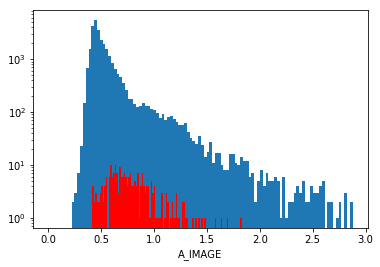

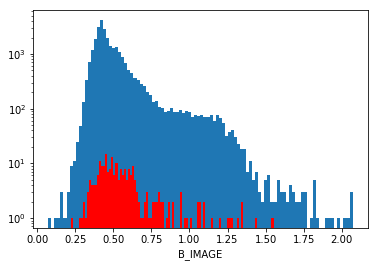

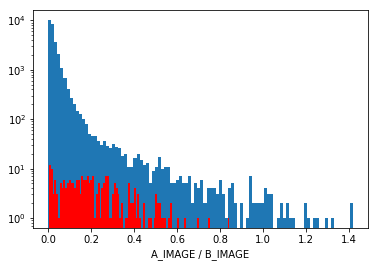

In [18]:
ws_hsc = t_test[wrong_stars]

dists, inds = match_lists.match_lists(ws_hsc["RA"], ws_hsc["DEC"], \
                                      t_hst["ALPHAPEAK_J2000"], t_hst["DELTAPEAK_J2000"], 2.0/3600.0)

match = np.where((inds != len(t_hst)))[0]

ws_hsc = t_hst[match]

print(len(match), len(ws_hsc))

plt.hist(np.log10(t_hst["A_IMAGE"][t_hst["MU_CLASS"] == 2]), bins=100)
plt.hist(np.log10(t_hst["A_IMAGE"][t_hst["MU_CLASS"] == 0]), bins=100)
plt.hist(np.log10(ws_hsc["A_IMAGE"]), bins=100, color="r")
plt.yscale("log")
plt.xlabel("A_IMAGE")
plt.show()

plt.hist(np.log10(t_hst["B_IMAGE"][t_hst["MU_CLASS"] == 2]), bins=100)
plt.hist(np.log10(ws_hsc["B_IMAGE"]), bins=100, color="r")
plt.yscale("log")
plt.xlabel("B_IMAGE")
plt.show()

ab = t_hst["A_IMAGE"]/t_hst["B_IMAGE"]
ab_w = ws_hsc["A_IMAGE"]/ws_hsc["B_IMAGE"]

plt.hist(np.log10(ab[t_hst["MU_CLASS"] == 2]), bins=100)
plt.hist(np.log10(ab_w), bins=100, color="r")
plt.yscale("log")
plt.xlabel("A_IMAGE / B_IMAGE")
plt.show()

69
149.877105905 1.93637725429
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_043_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_043_sci.fits



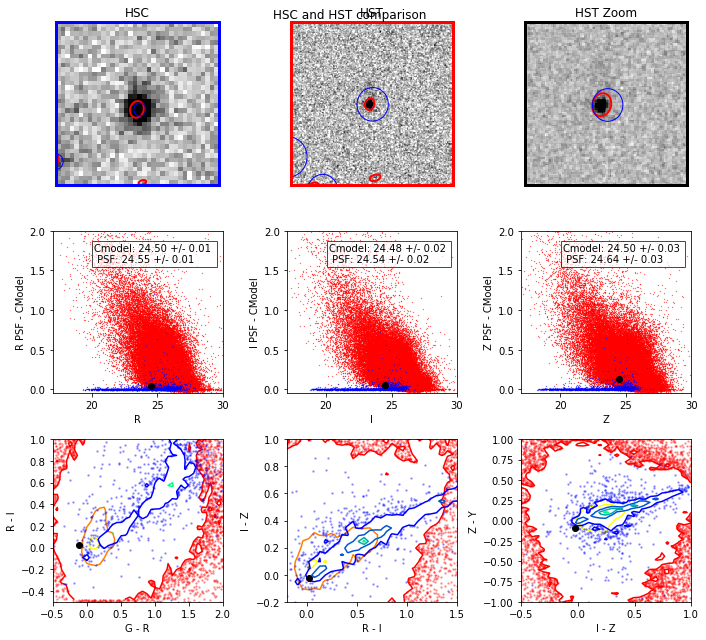

150.079519049 2.67493420577
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_101_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_101_sci.fits



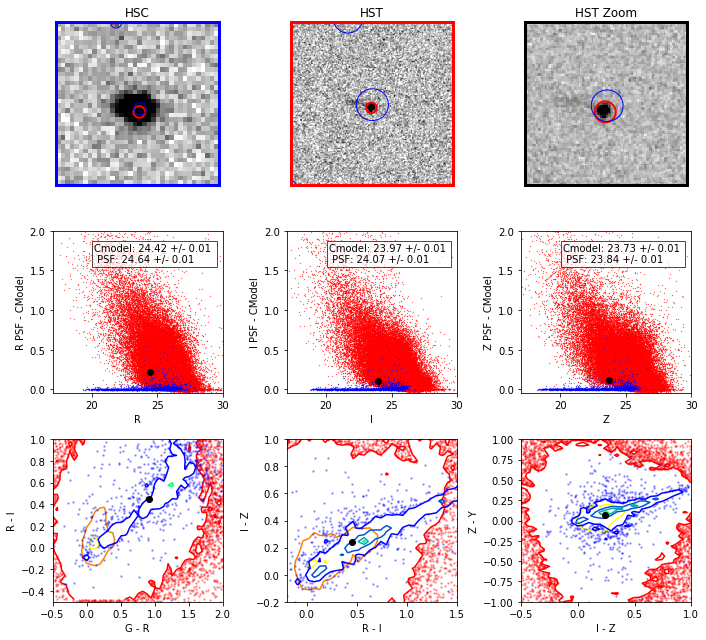

149.95423184 1.77239490009
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_030_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_030_sci.fits



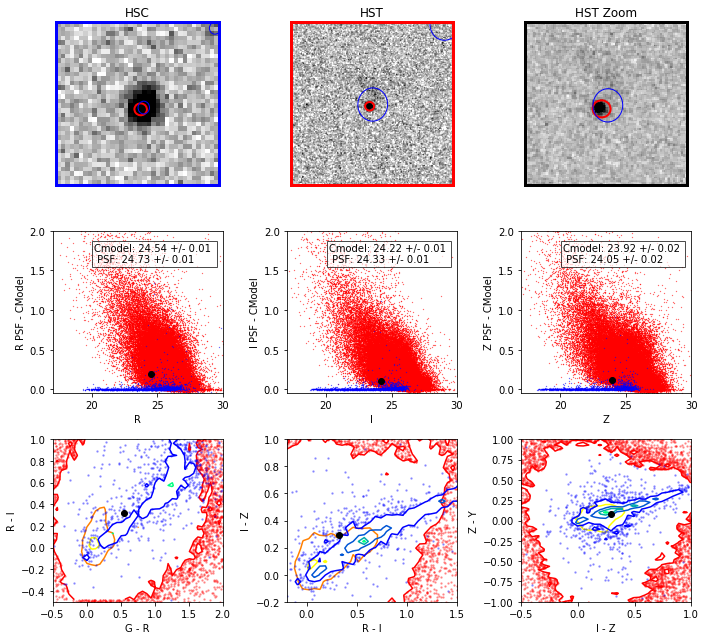

149.939835212 2.42652801669
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_078_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_078_sci.fits



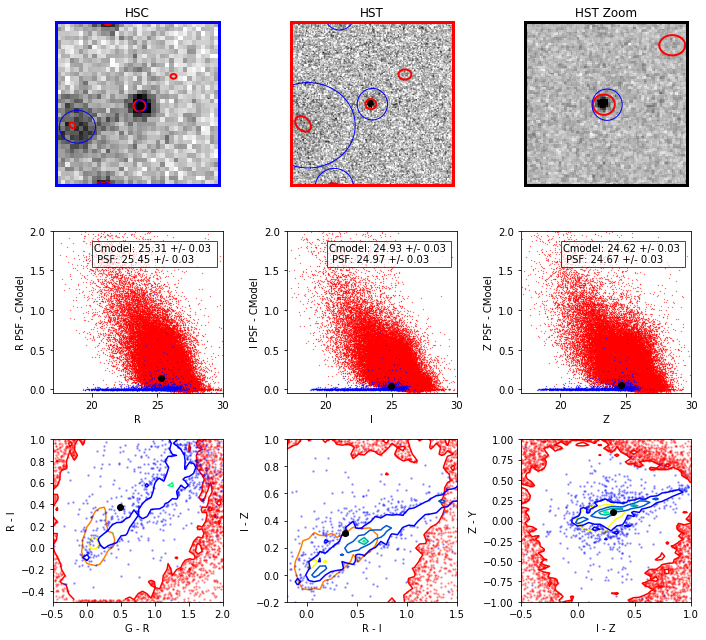

149.707183514 1.96868484775
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_056_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_056_sci.fits



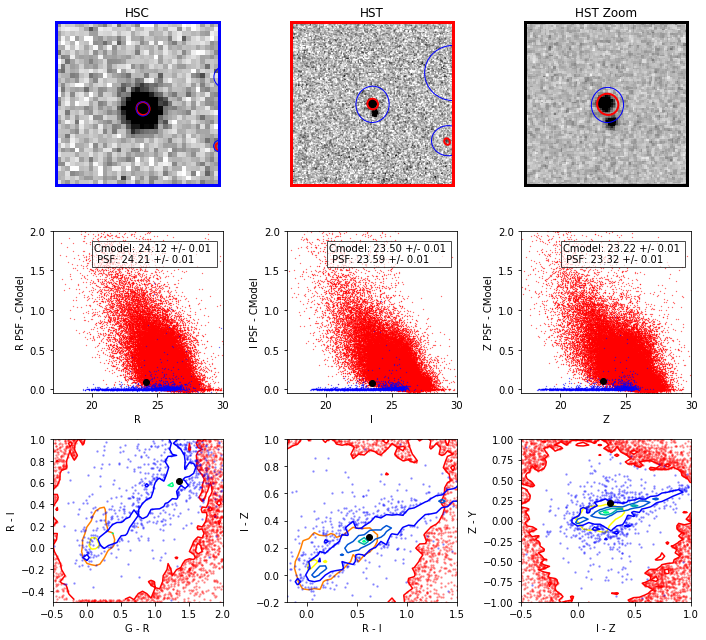

149.58021118 1.70780036606
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_032_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_032_sci.fits



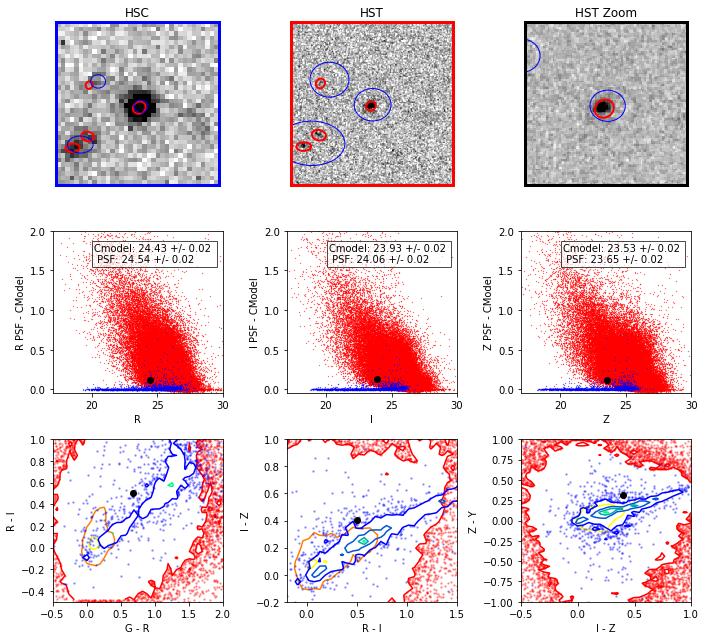

150.114990141 2.68029924267
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_101_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_101_sci.fits



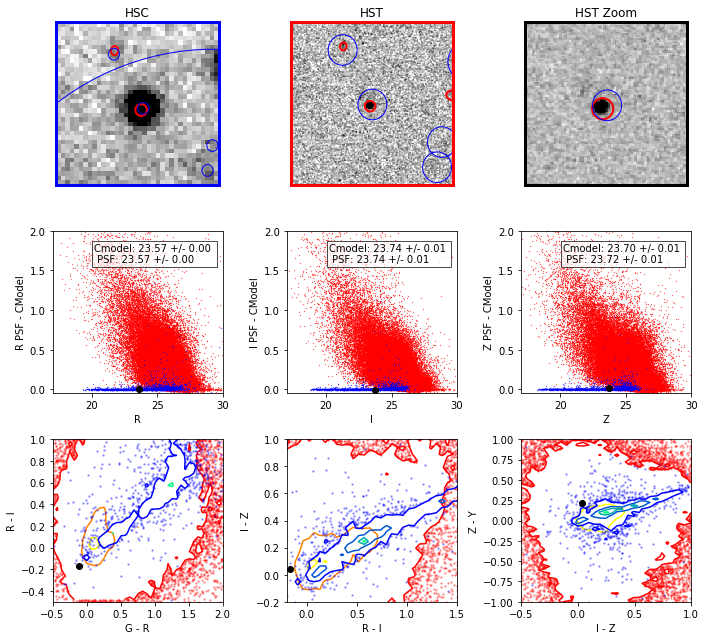

150.700722423 1.89543566574
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_038_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_038_sci.fits



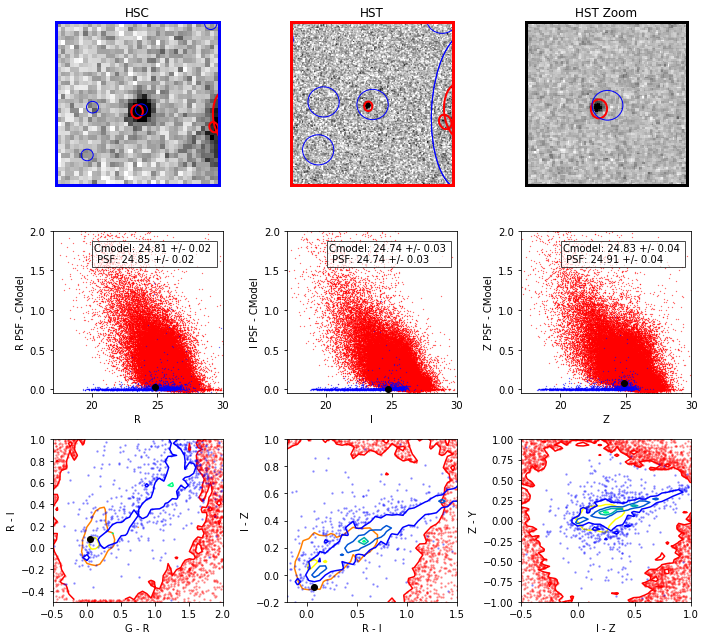

150.055263292 2.81813274539
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_114_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_114_sci.fits



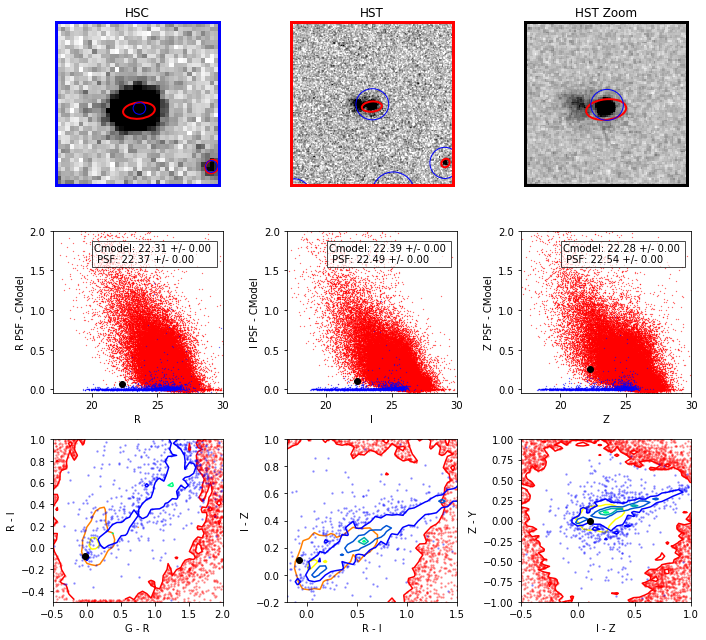

150.268961861 2.5802984351
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_088_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_088_sci.fits



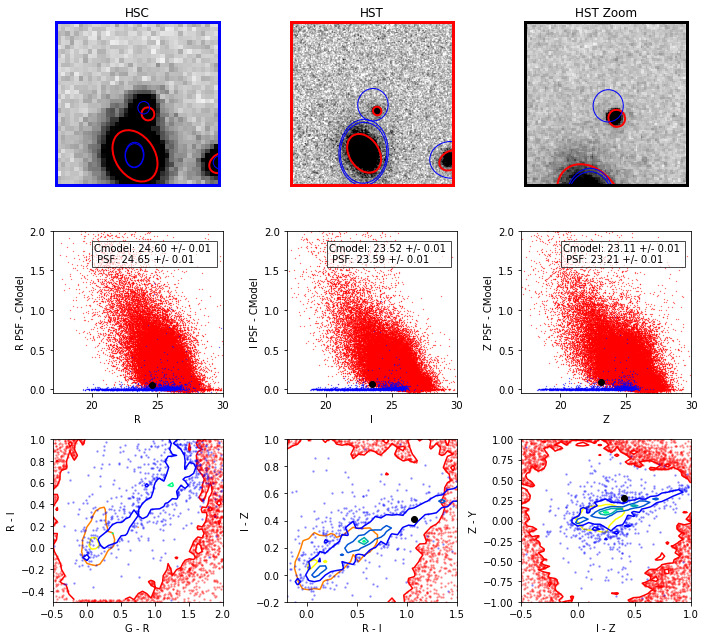

150.341052226 2.36714768374
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_076_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_076_sci.fits



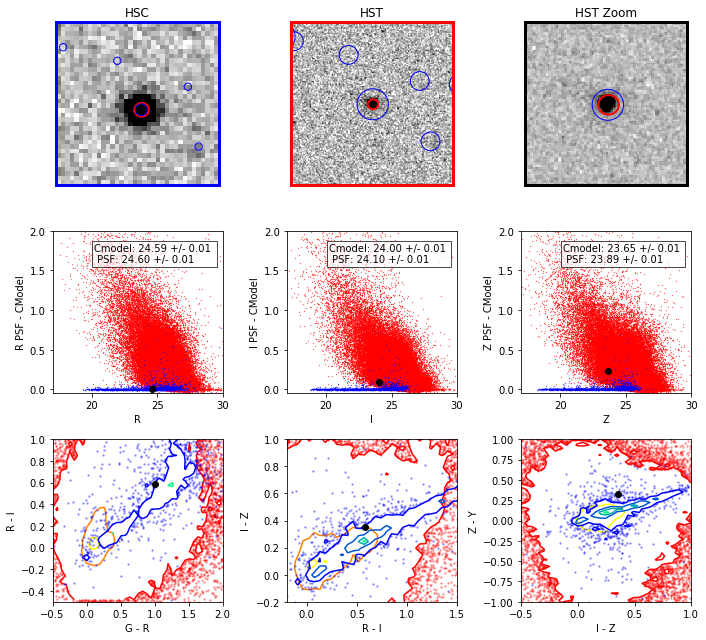

150.310971789 1.82956087022
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_040_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_040_sci.fits



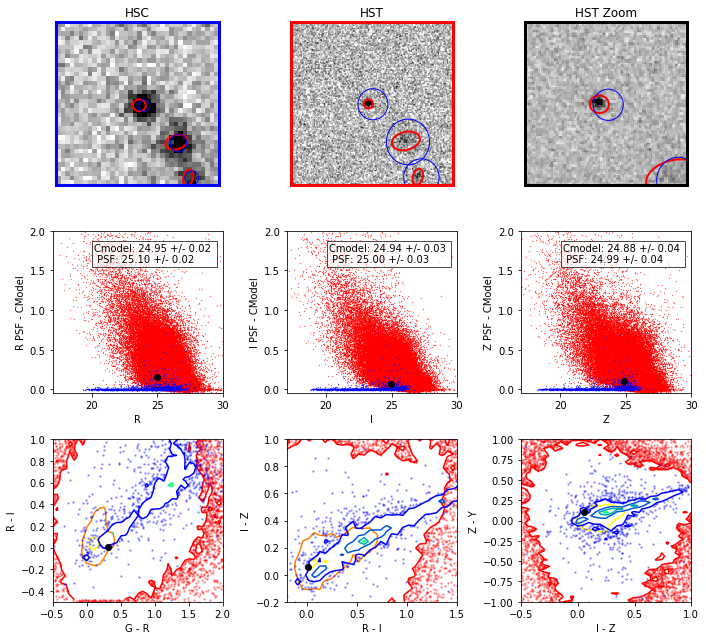

150.664750445 1.64013489977
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_026_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_026_sci.fits



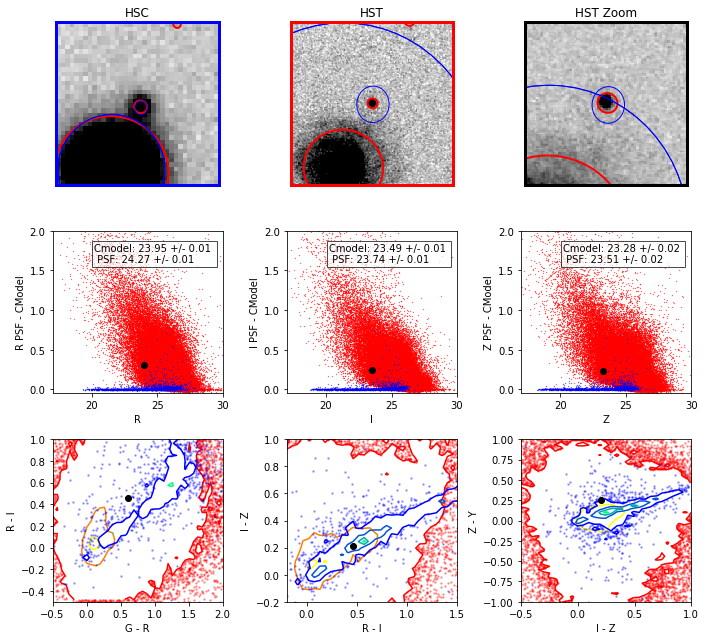

149.627447526 2.46933885411
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_092_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_092_sci.fits



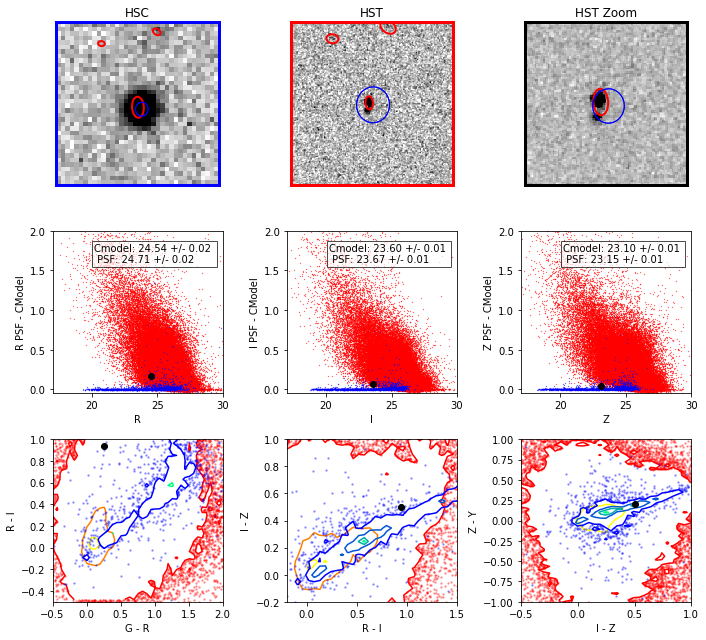

150.246541389 1.7004071511
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_028_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_028_sci.fits



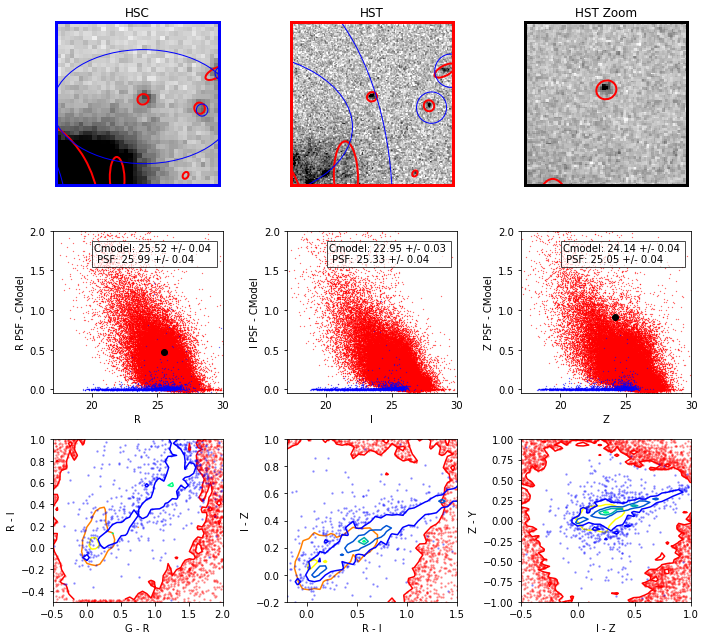

149.626742578 2.03569963889
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_056_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_056_sci.fits



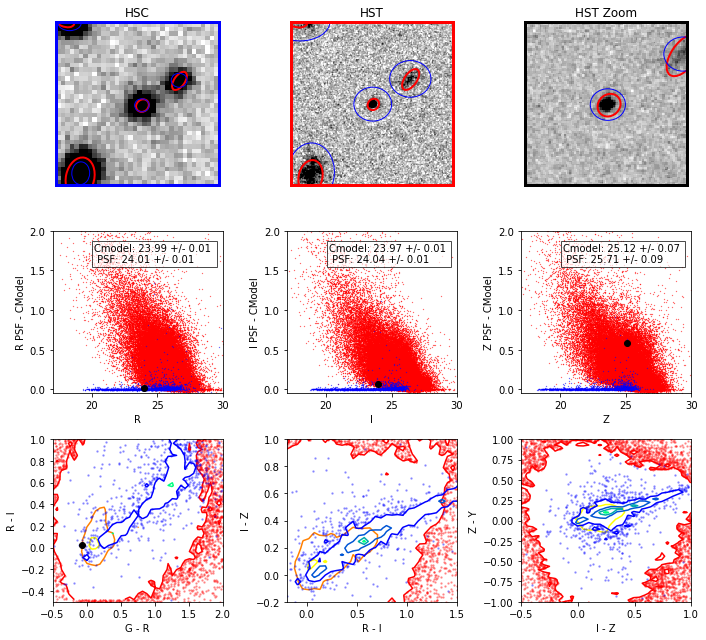

150.139207316 2.07695452153
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_053_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_053_sci.fits



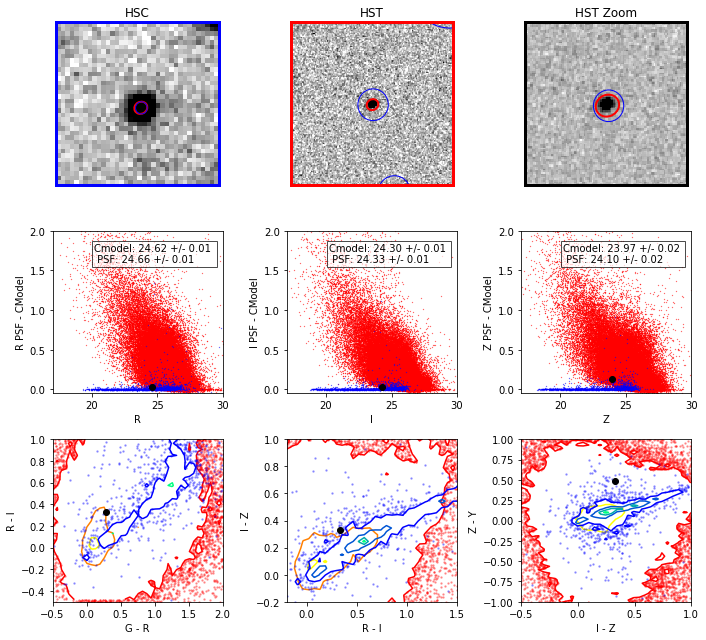

150.338570608 1.75722067223
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_028_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_028_sci.fits



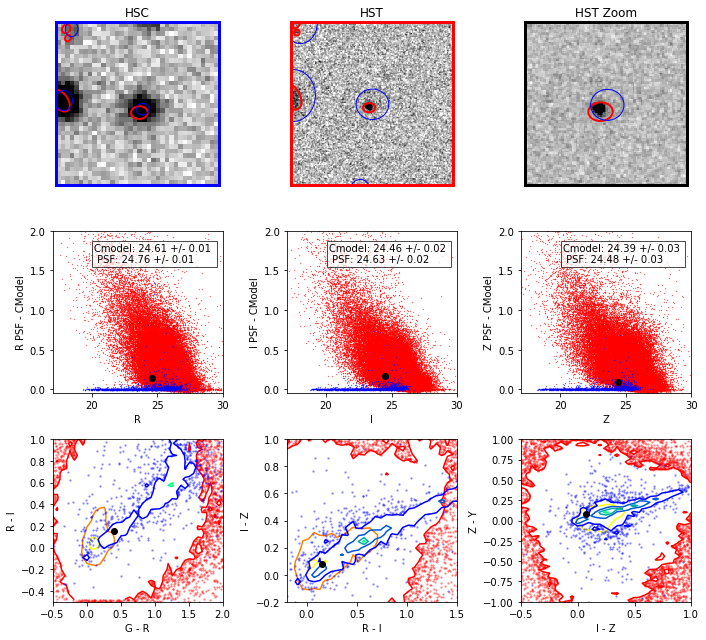

149.756341395 2.11733829418
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_055_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_055_sci.fits



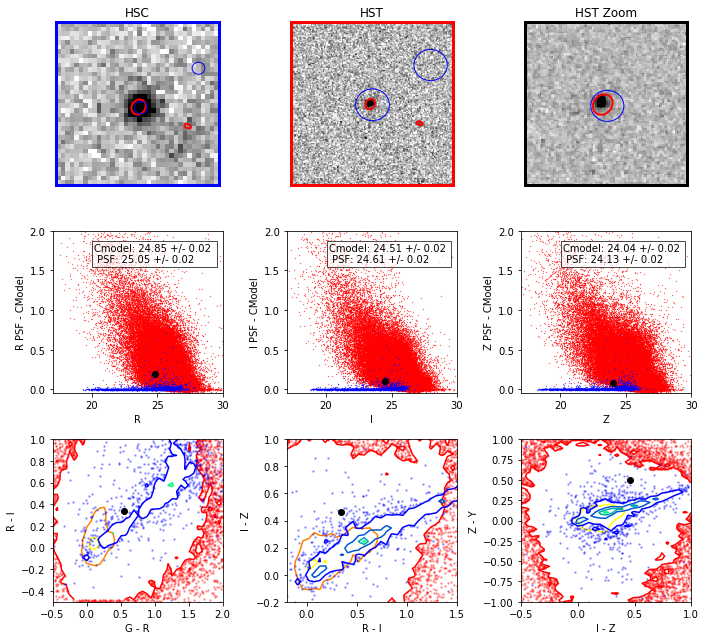

150.182345268 1.94932107883
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_041_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_041_sci.fits



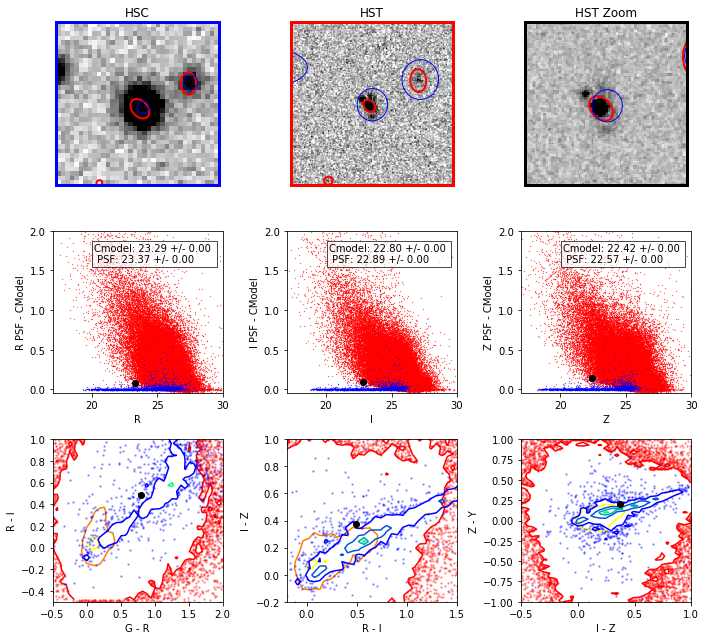

150.038195601 2.16639347626
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_066_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_066_sci.fits



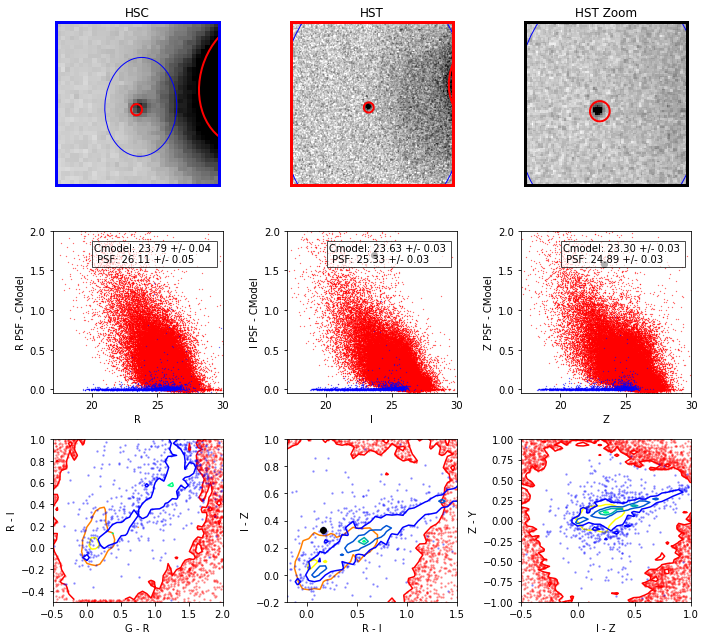

149.818253771 2.83258802744
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_115_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_115_sci.fits



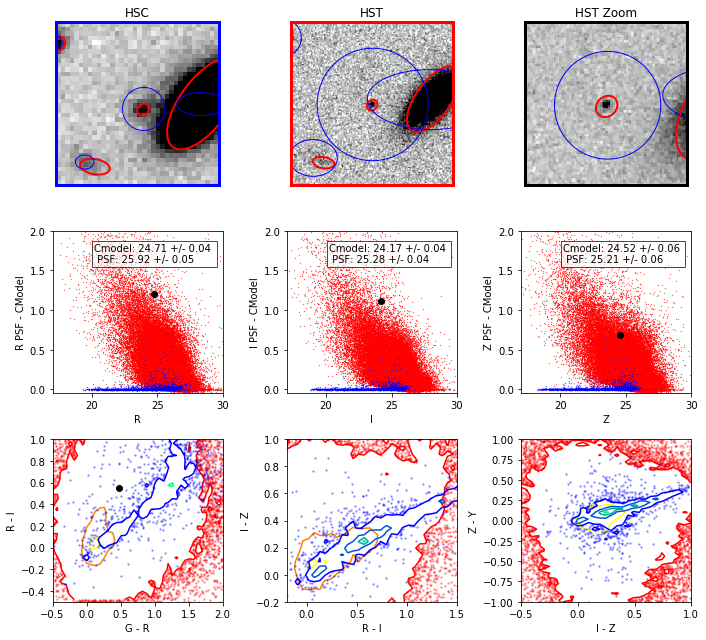

150.529078229 1.78539075793
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_027_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_027_sci.fits



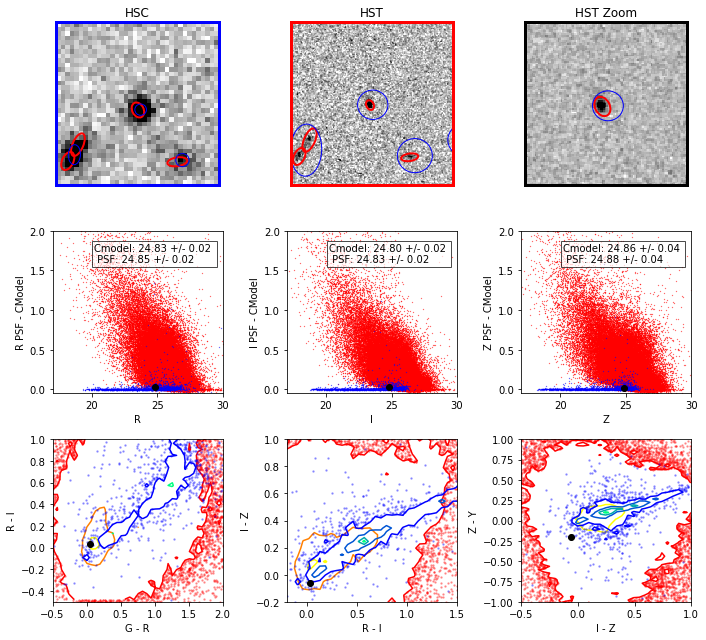

149.783826002 1.96895654909
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_055_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_055_sci.fits



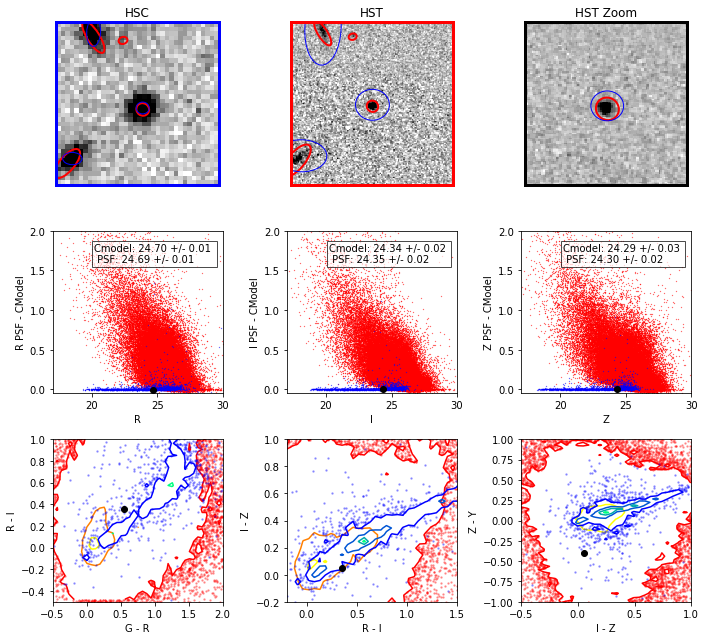

149.507542431 2.78496995751
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_105_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_105_sci.fits



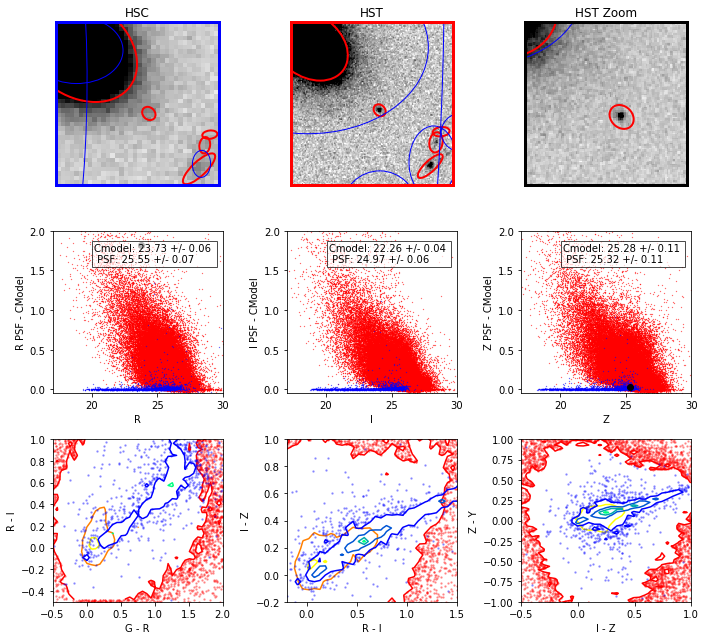

150.246155496 2.85818986803
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_112_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_112_sci.fits



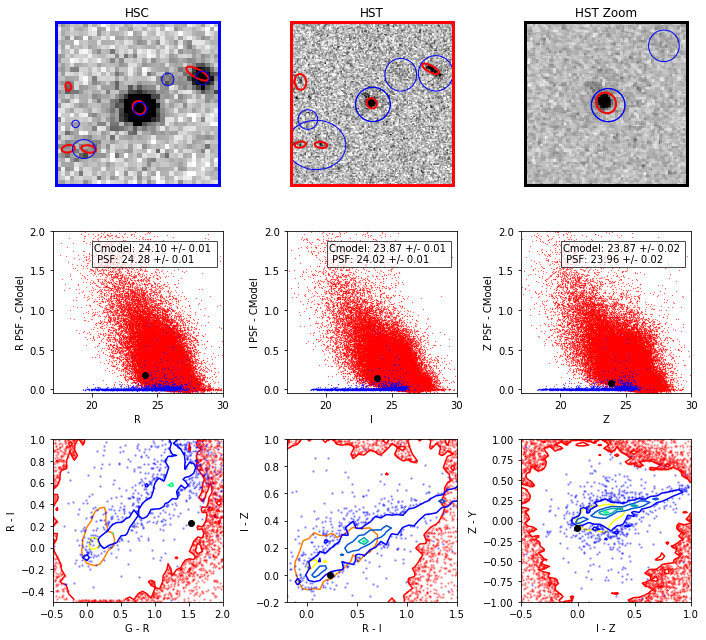

149.609571251 2.68957473465
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_104_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_104_sci.fits



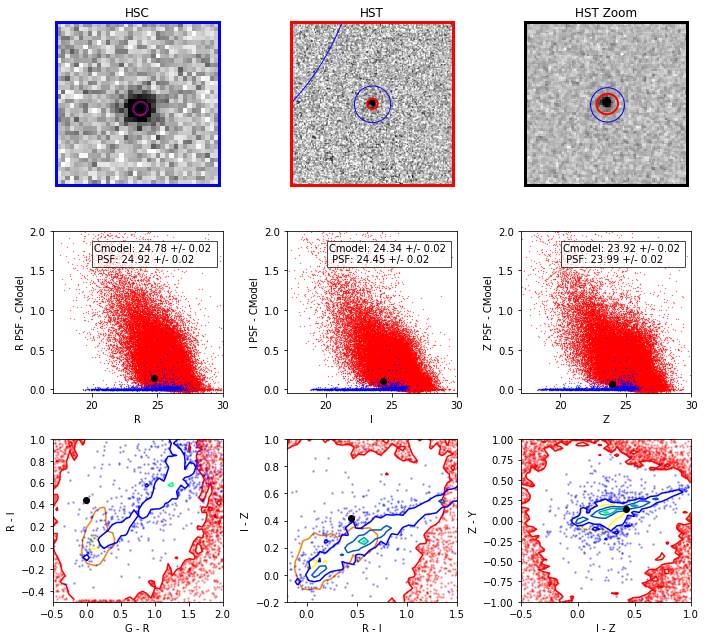

149.809344664 2.3736548851
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_079_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_079_sci.fits



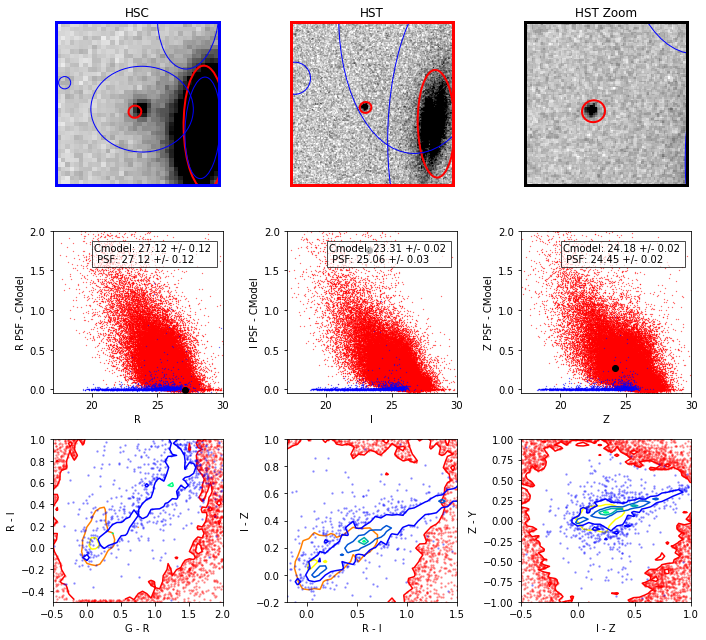

149.8043335 2.70077331423
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_103_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_103_sci.fits



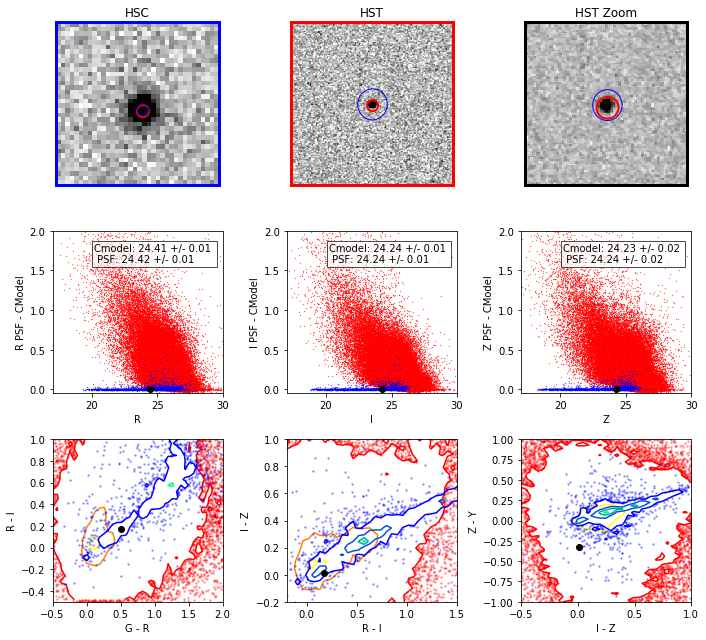

149.976493267 2.73625603824
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_102_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_102_sci.fits



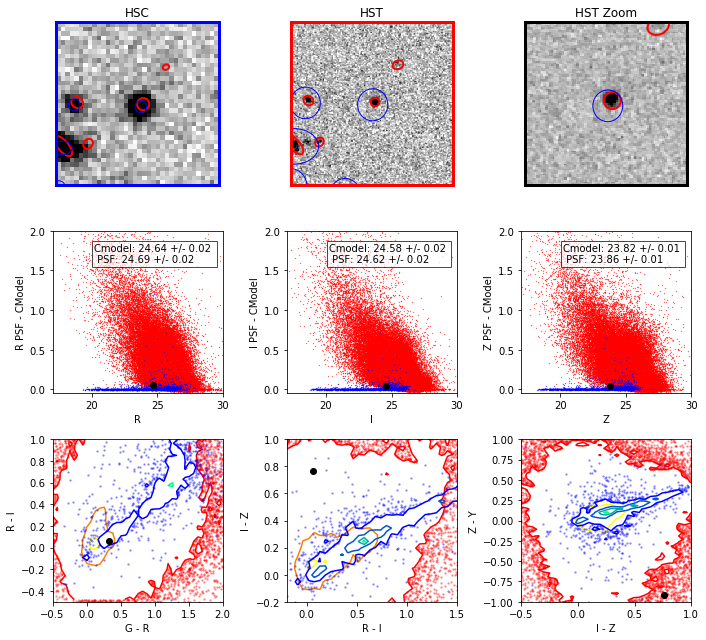

150.585971562 2.27016127911
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_062_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_062_sci.fits



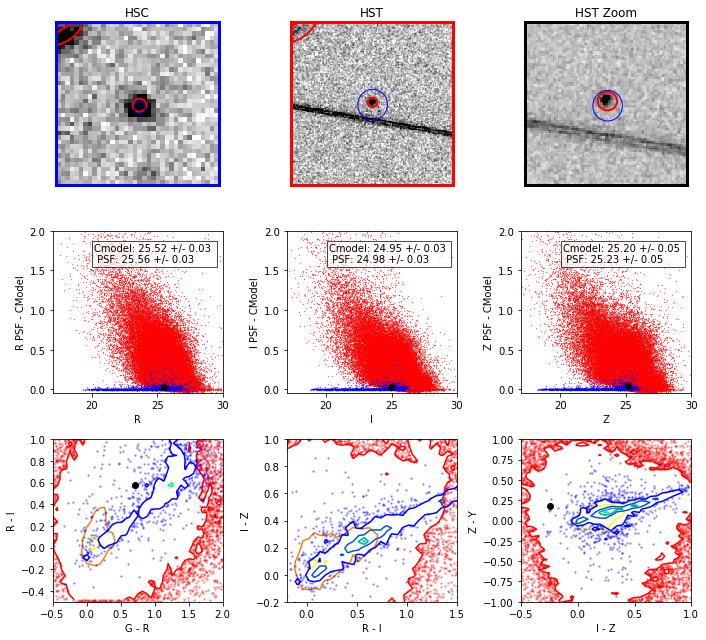

150.010799663 1.98816303384
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_054_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_054_sci.fits



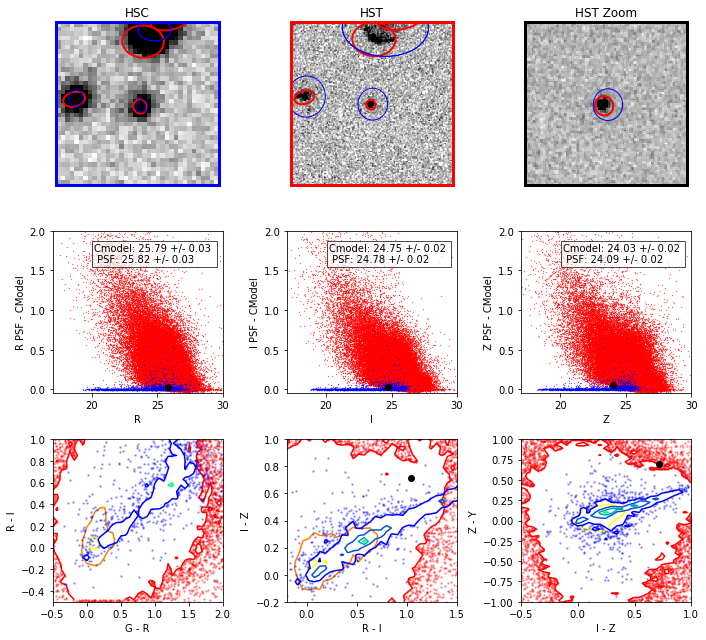

149.686430826 2.16291531949
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_068_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_068_sci.fits



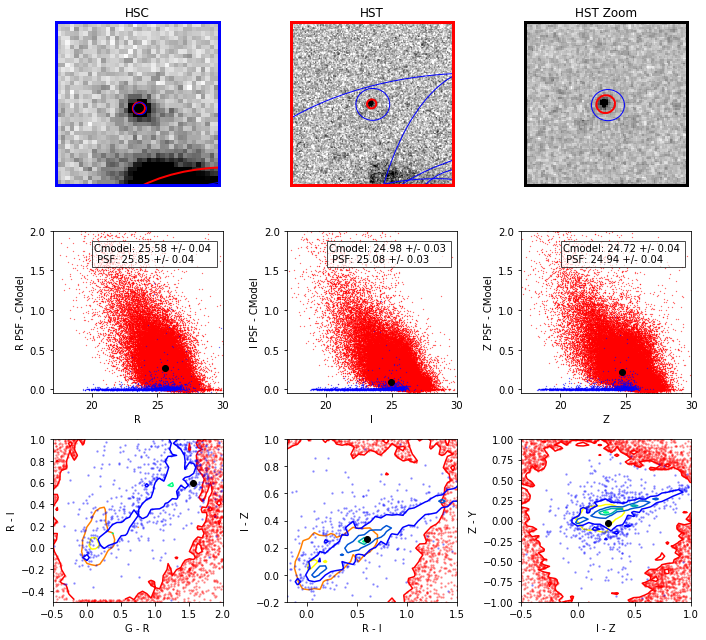

150.111577188 2.54972569937
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_089_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_089_sci.fits



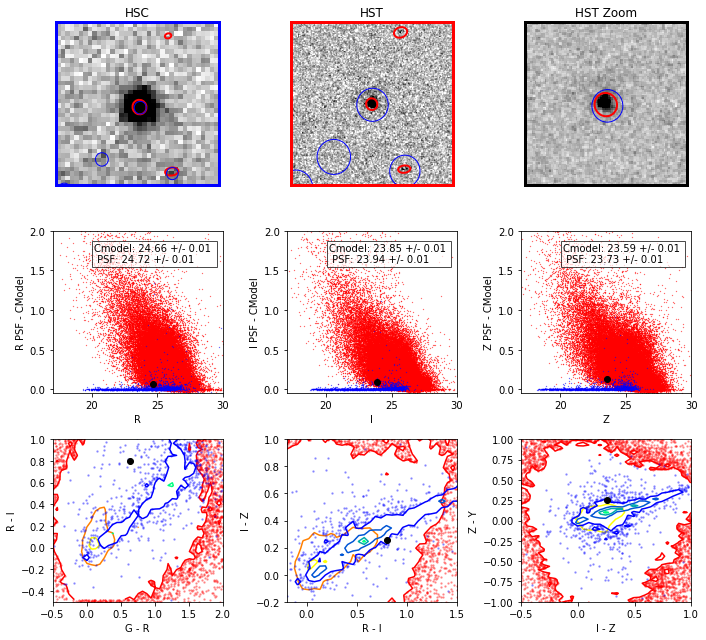

149.69605947 2.72835305441
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_104_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_104_sci.fits



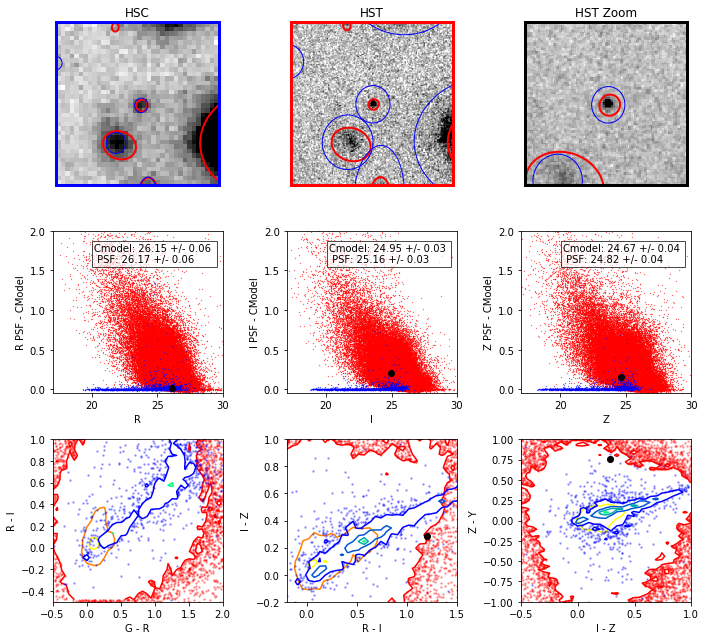

150.092043681 1.76537438367
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_029_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_029_sci.fits



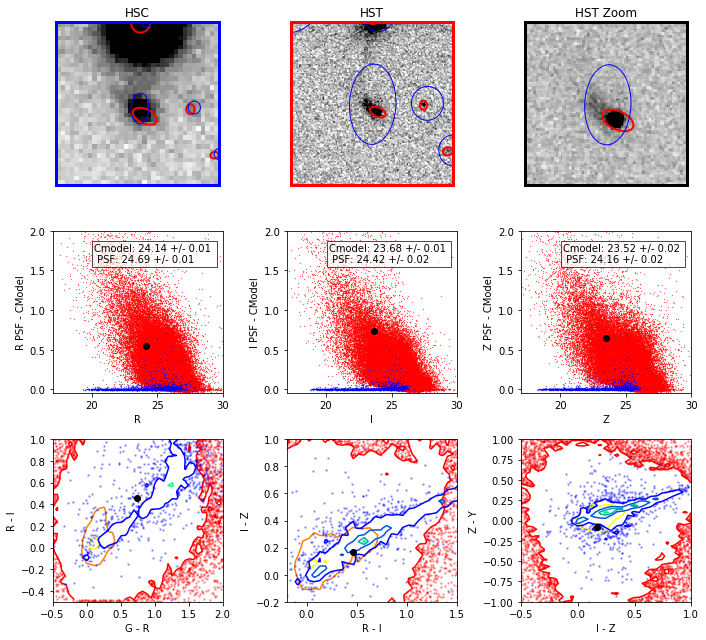

149.963809308 2.42768490766
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_078_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_078_sci.fits



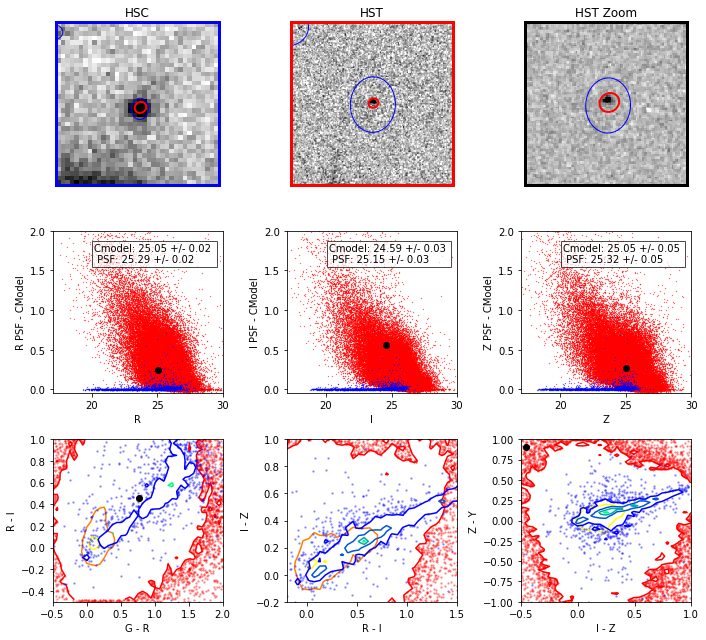

150.376223756 1.88161719498
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_040_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_040_sci.fits



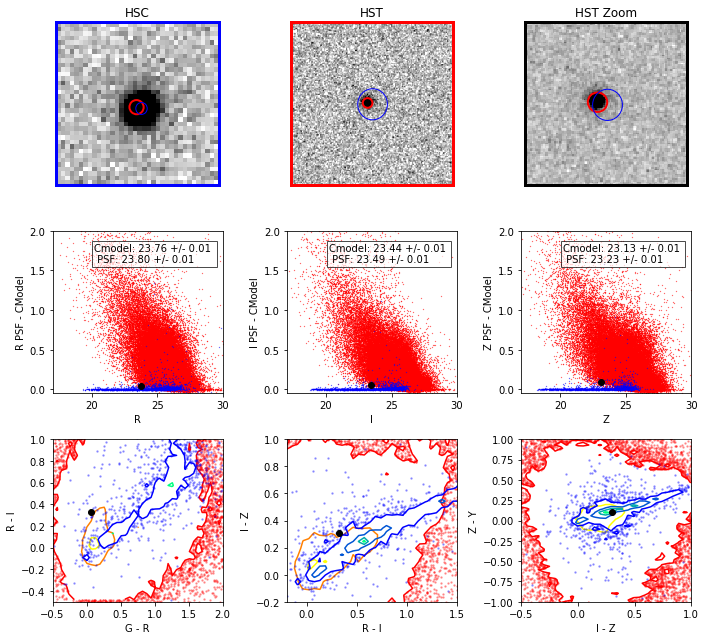

150.464220103 2.07192030946
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_051_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_051_sci.fits



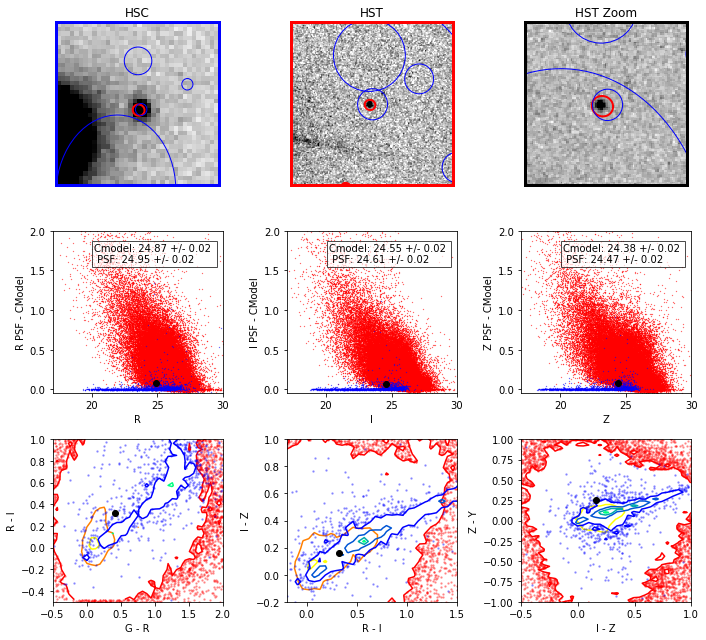

150.661622398 2.59582071276
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_086_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_086_sci.fits



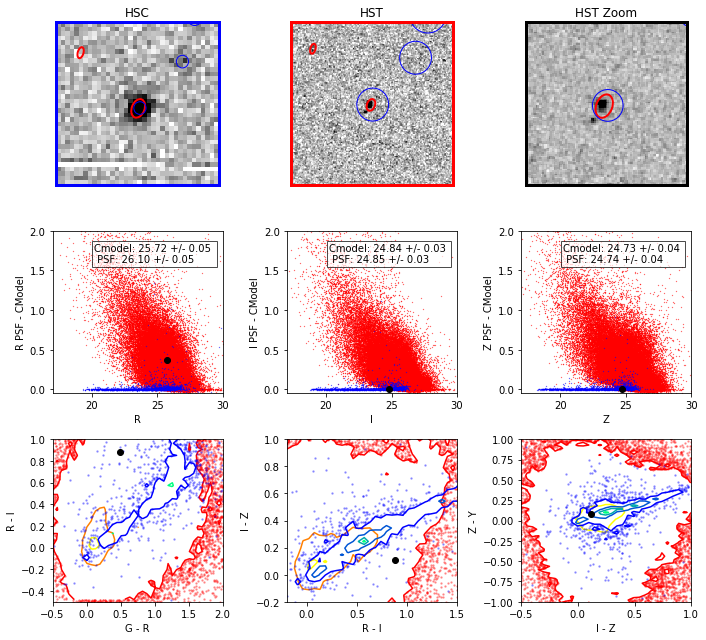

150.446139075 2.55686913833
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_087_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_087_sci.fits



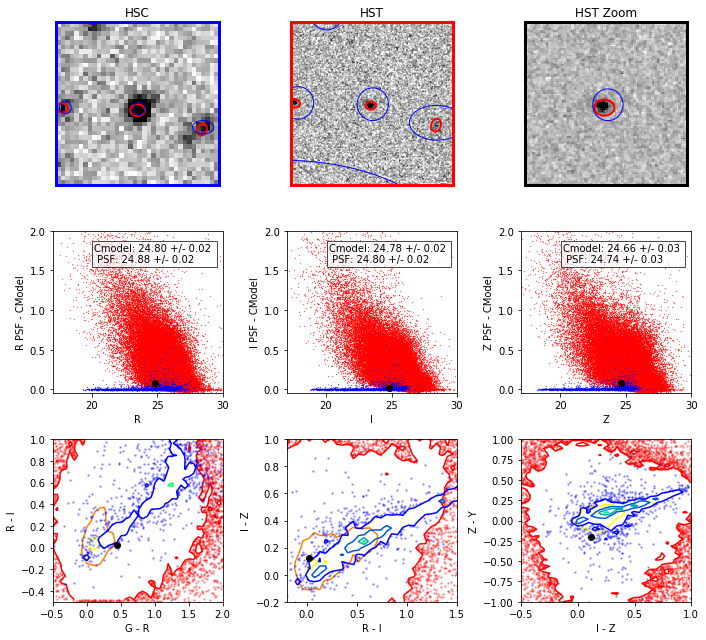

150.151262278 1.66779597936
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_029_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_029_sci.fits



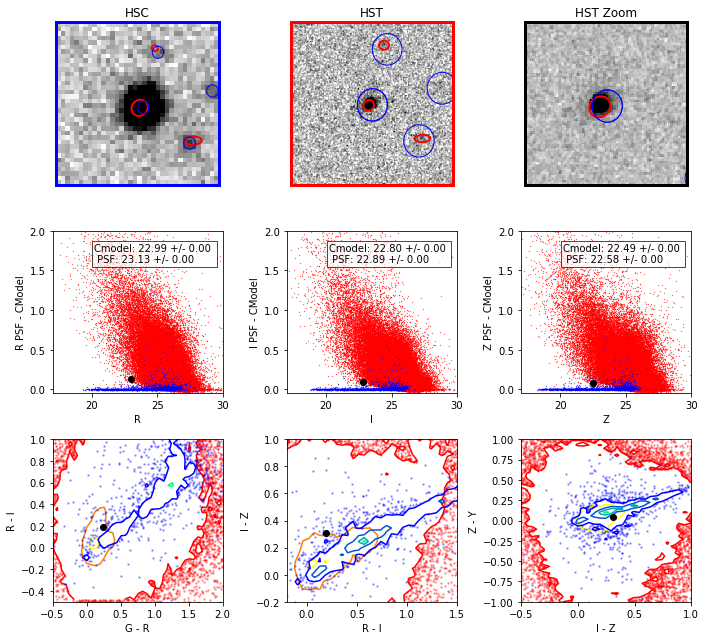

149.523873832 2.79022722159
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_105_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_105_sci.fits



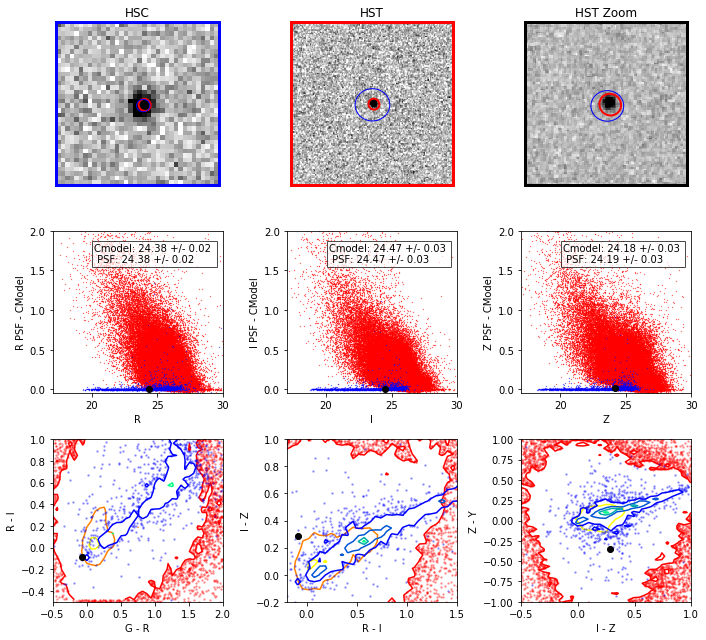

150.281741115 2.21935394284
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_064_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_064_sci.fits



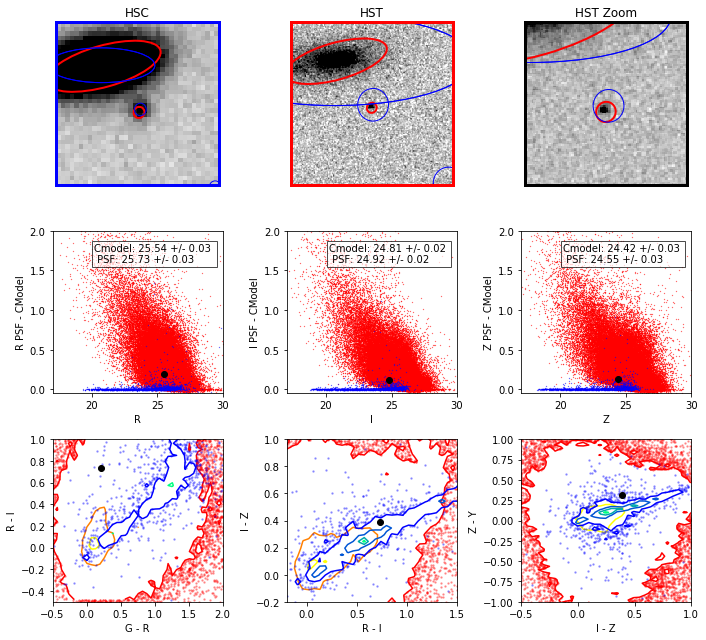

149.928442437 2.25304179185
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_066_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_066_sci.fits



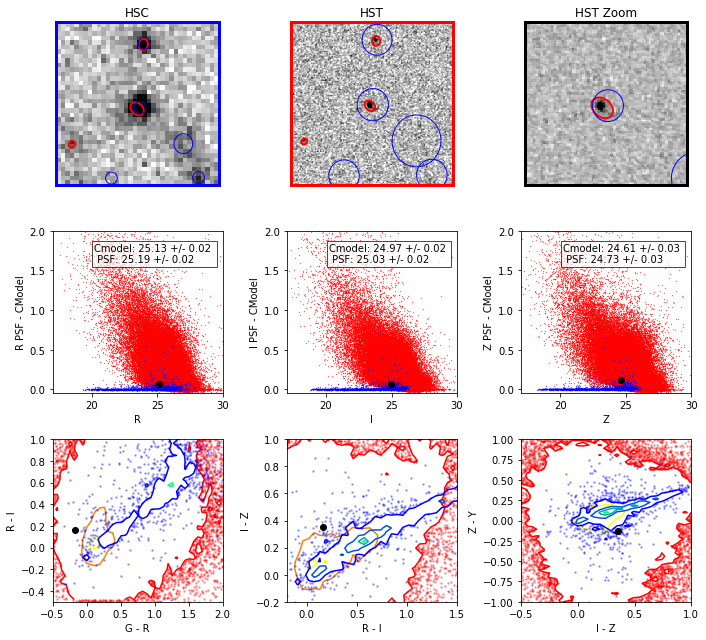

149.831340942 2.30215442191
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_079_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_079_sci.fits



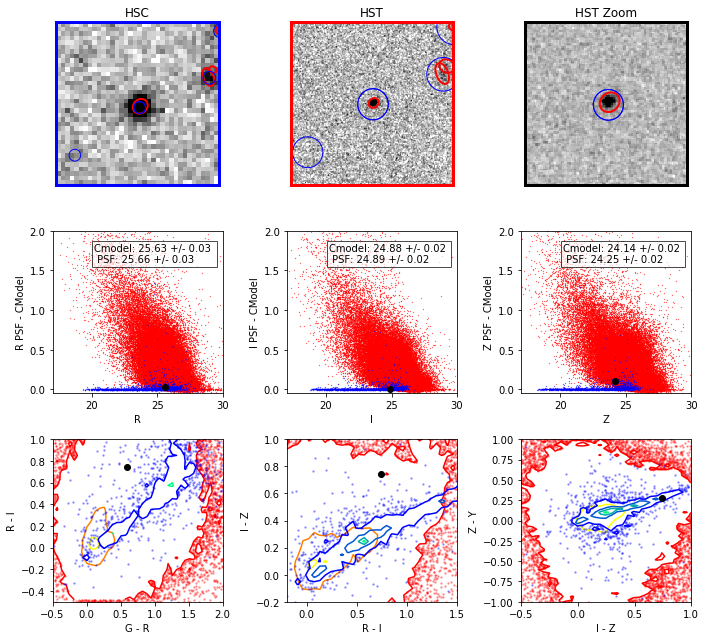

150.029588759 1.86483532003
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_042_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_042_sci.fits



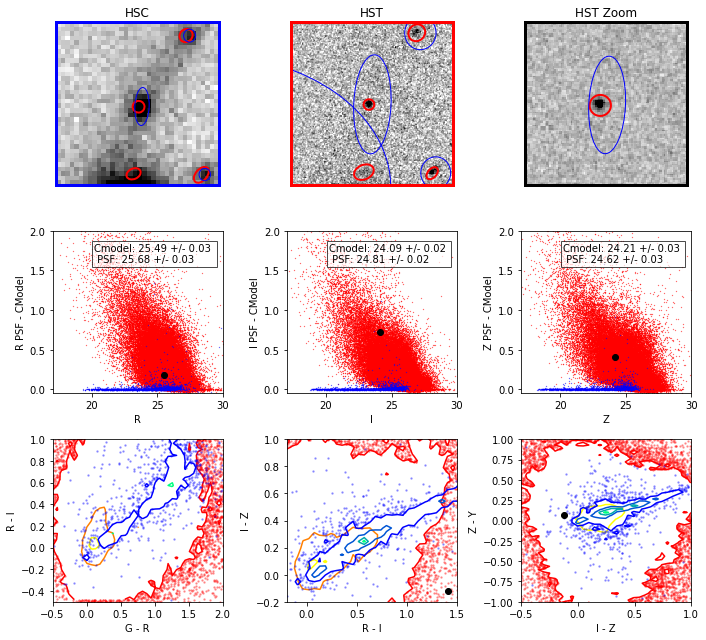

149.772143474 1.67525159246
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_031_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_031_sci.fits



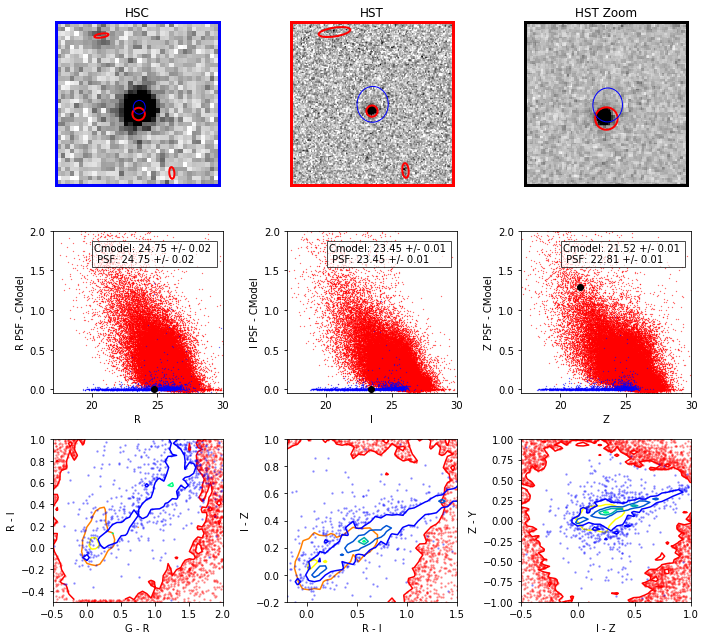

150.234906619 2.07457430777
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_052_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_052_sci.fits



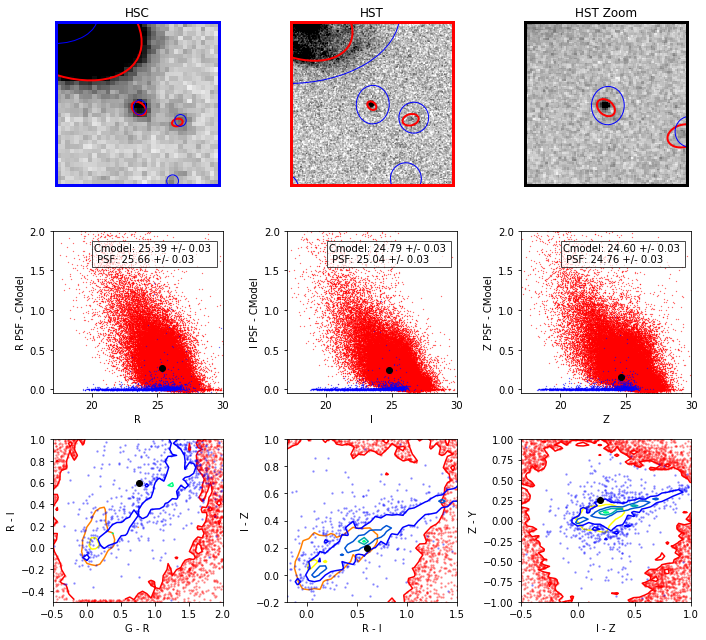

150.524047265 2.19209777764
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_063_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_063_sci.fits



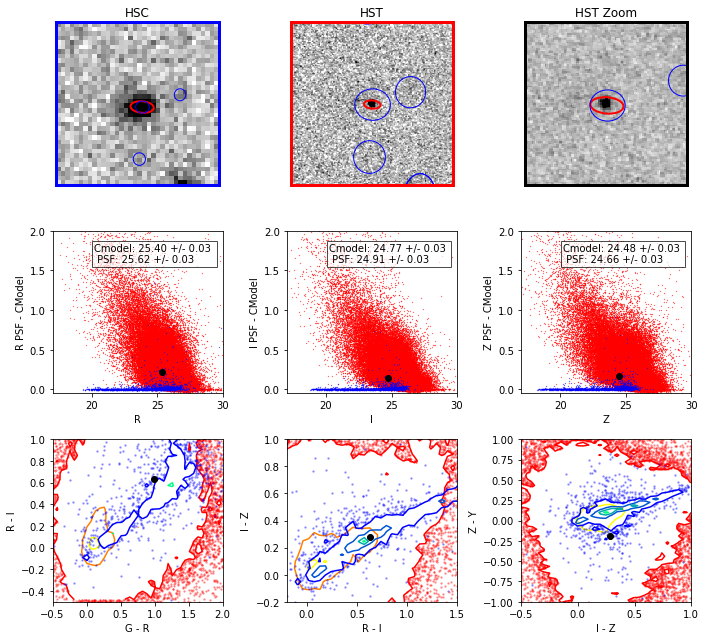

149.797347591 2.14937217204
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_067_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_067_sci.fits



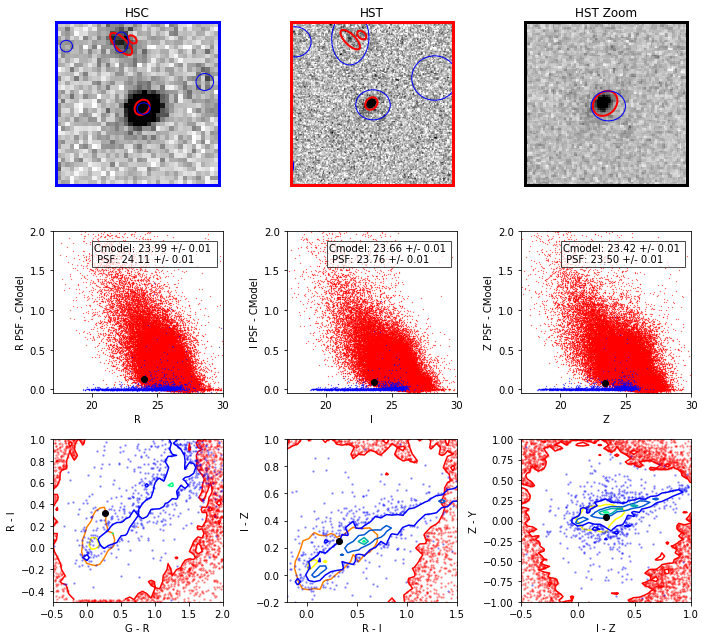

149.794867592 2.77979689851
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_103_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_103_sci.fits



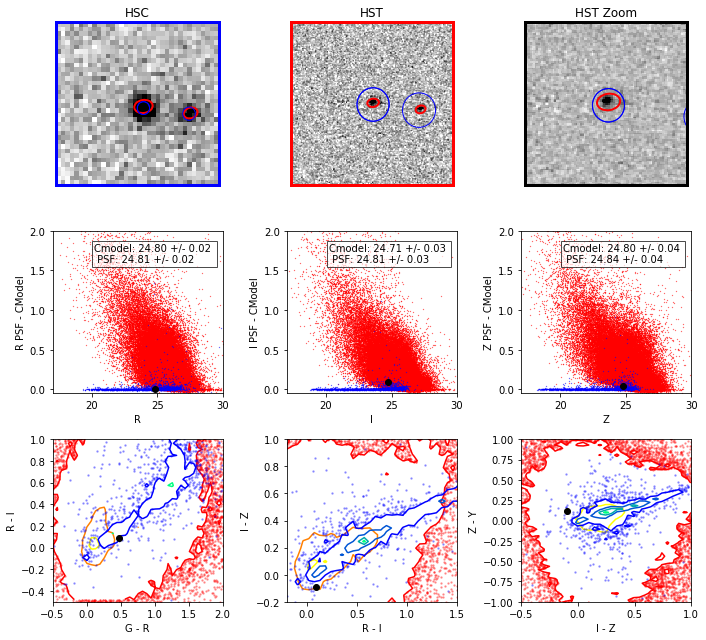

150.166499751 2.86947541185
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_113_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_113_sci.fits



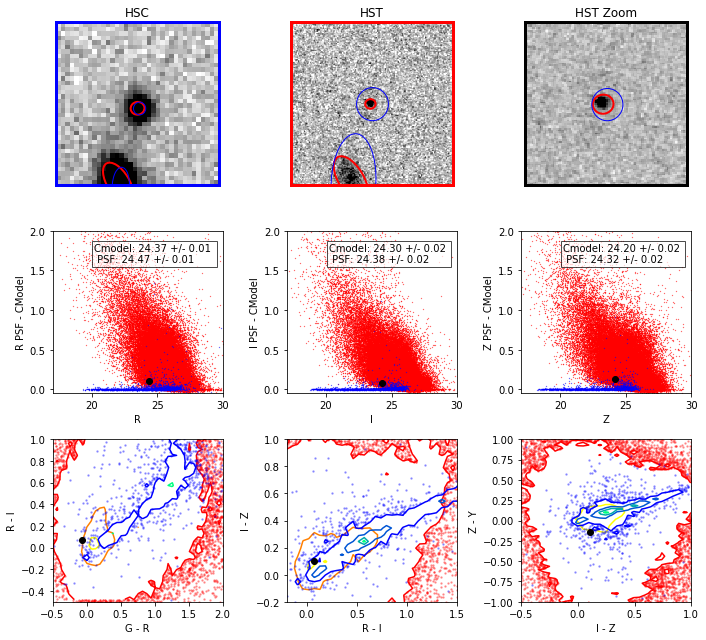

149.650941227 1.71591381544
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_032_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_032_sci.fits



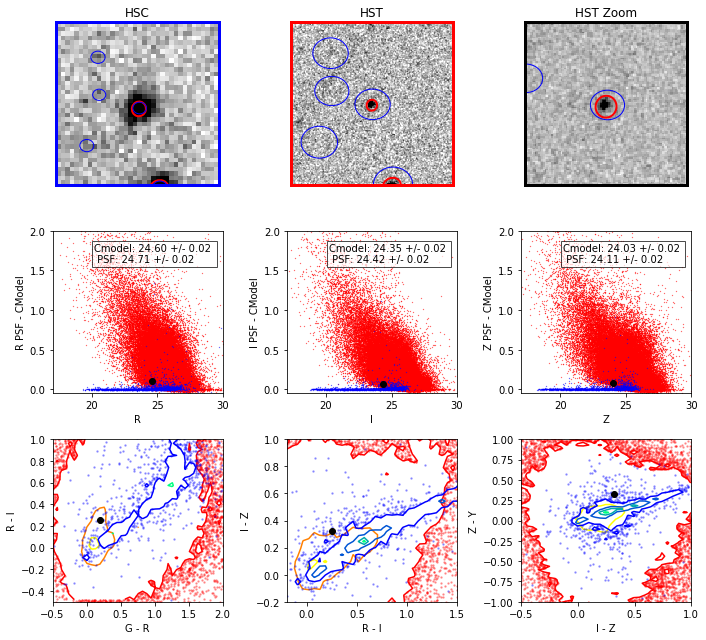

150.209983095 2.26017187504
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_065_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_065_sci.fits



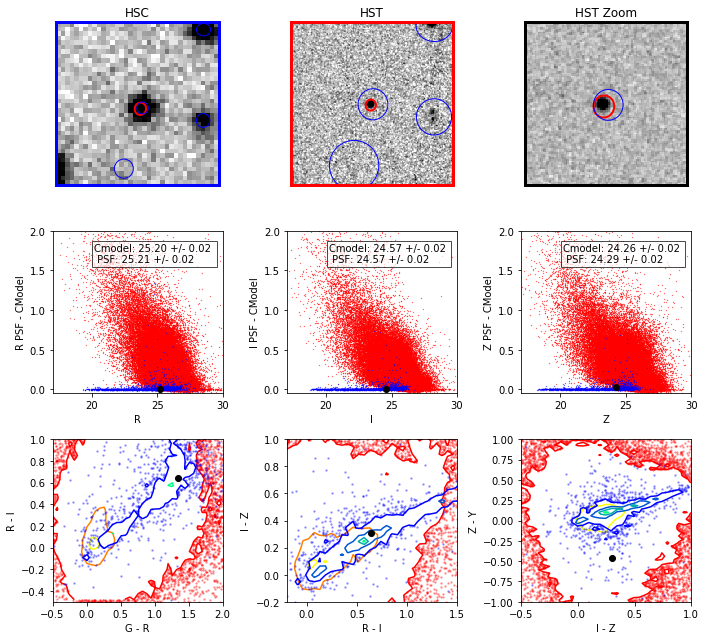

149.595286136 1.67357362964
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_032_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_032_sci.fits



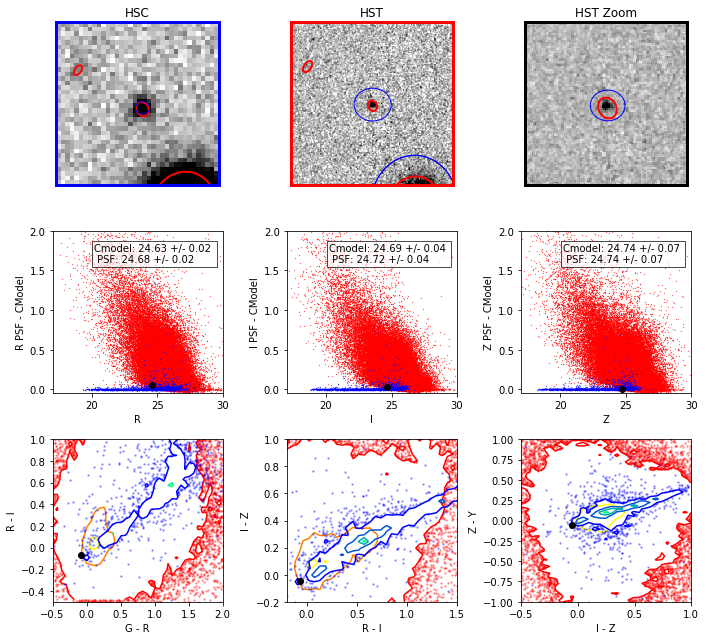

150.311566349 2.32327896883
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_076_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_076_sci.fits



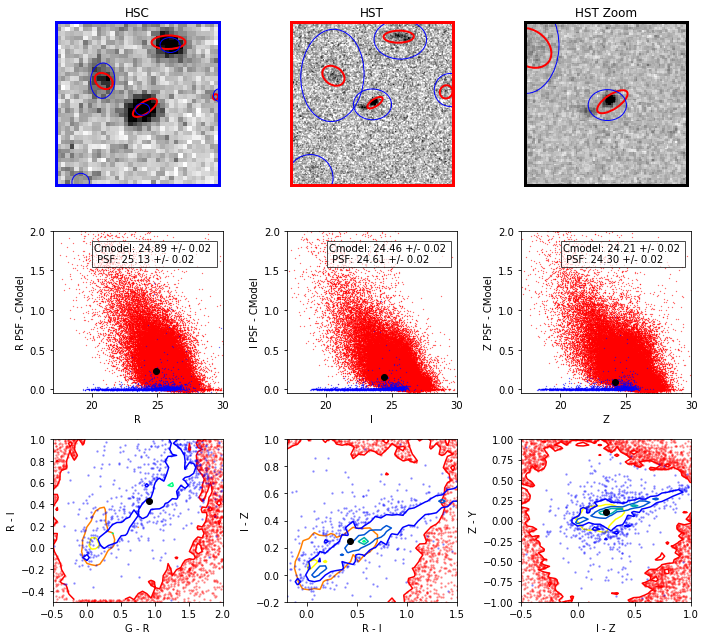

150.562486808 2.19192657798
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_062_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_062_sci.fits



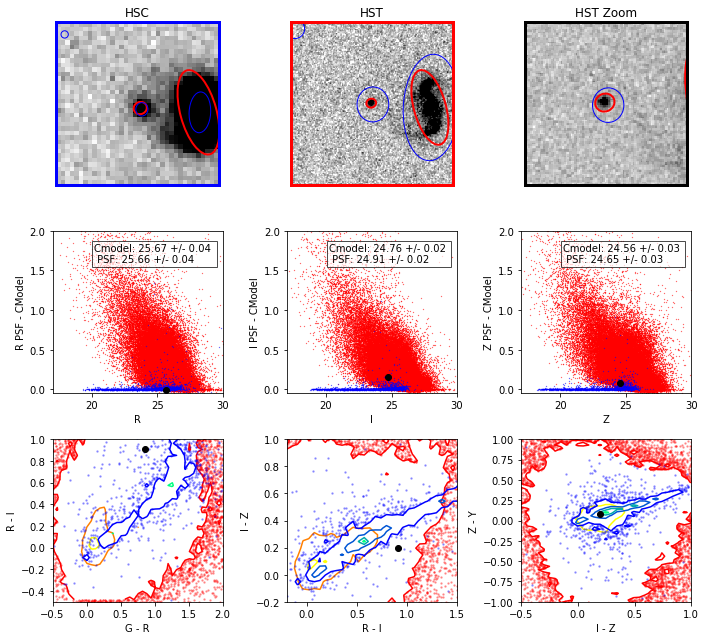

150.249301871 2.11337695998
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_052_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_052_sci.fits



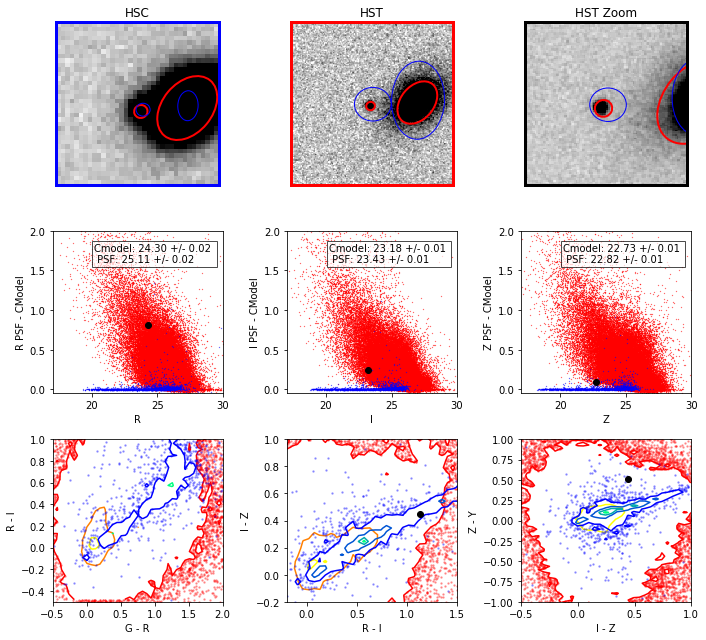

149.508032174 2.02866953154
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_057_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_057_sci.fits



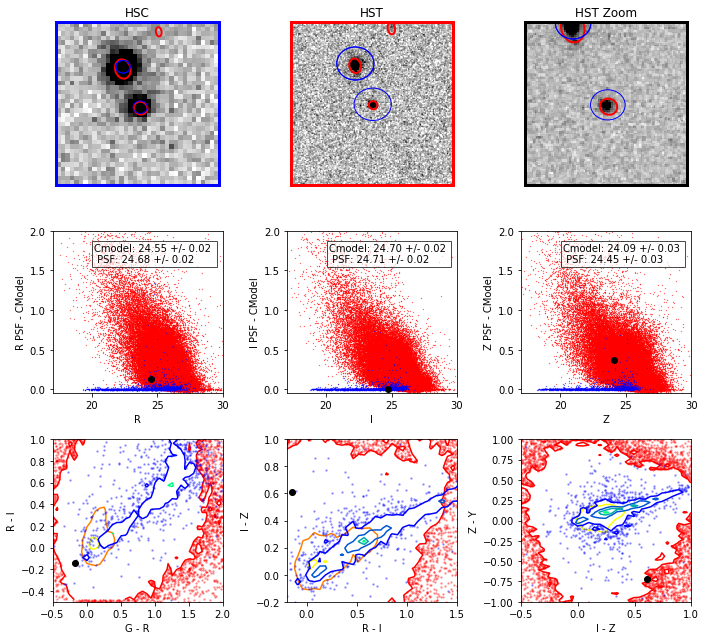

149.682799003 2.18438620306
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_068_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_068_sci.fits



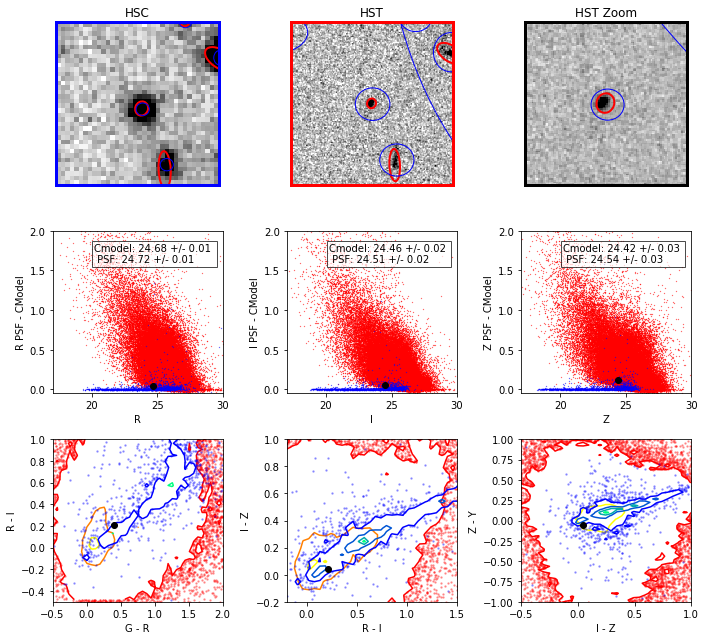

150.178912082 1.5838983433
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_017_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_017_sci.fits



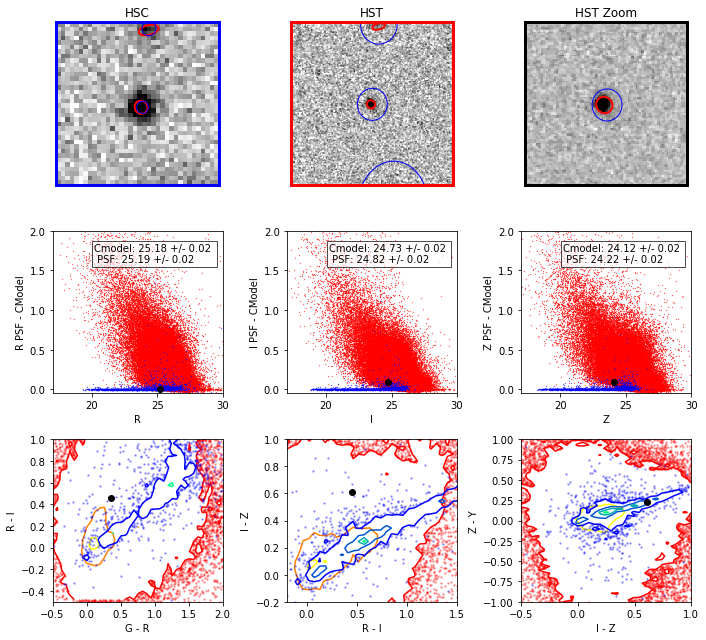

150.335568516 1.96048204685
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_040_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_040_sci.fits



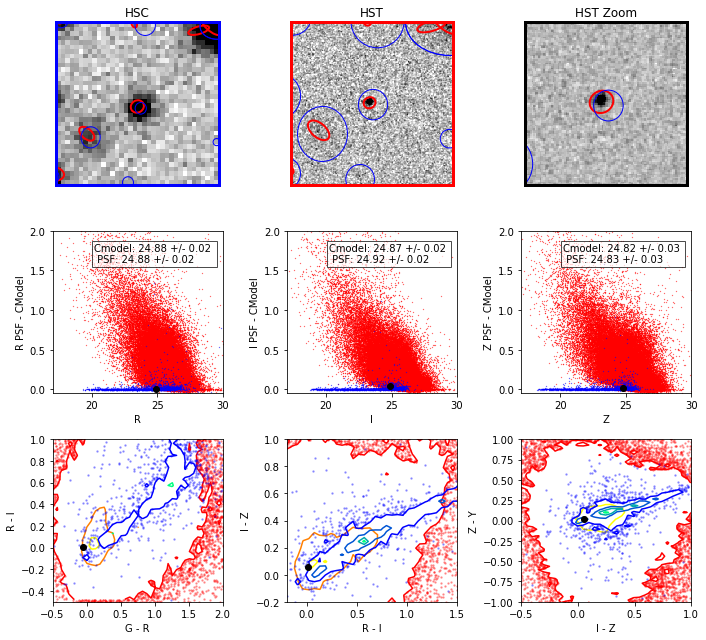

150.428200013 2.06188204057
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_051_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_051_sci.fits



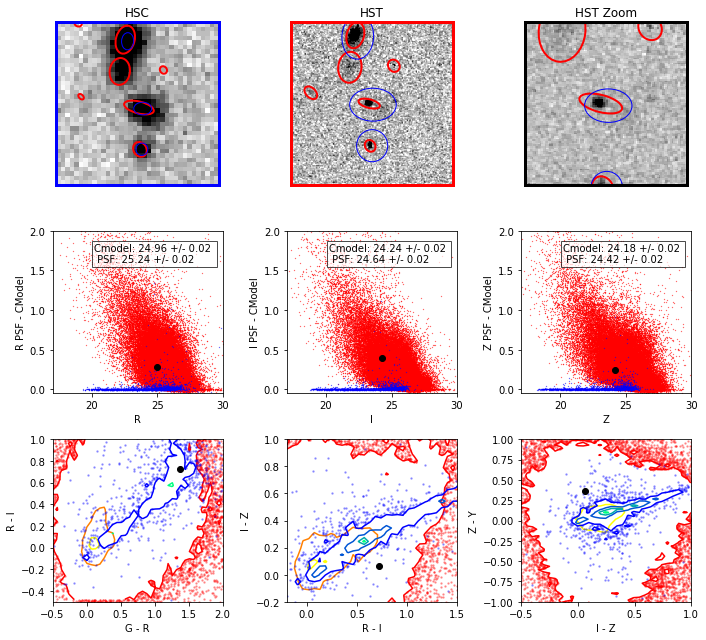

150.289902176 2.45483162354
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_076_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_076_sci.fits



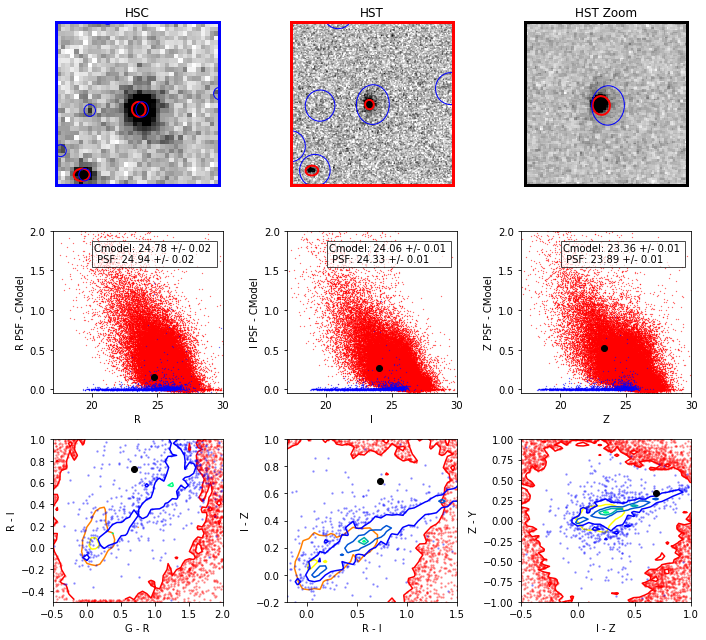

150.665132593 1.93461731648
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_038_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_038_sci.fits



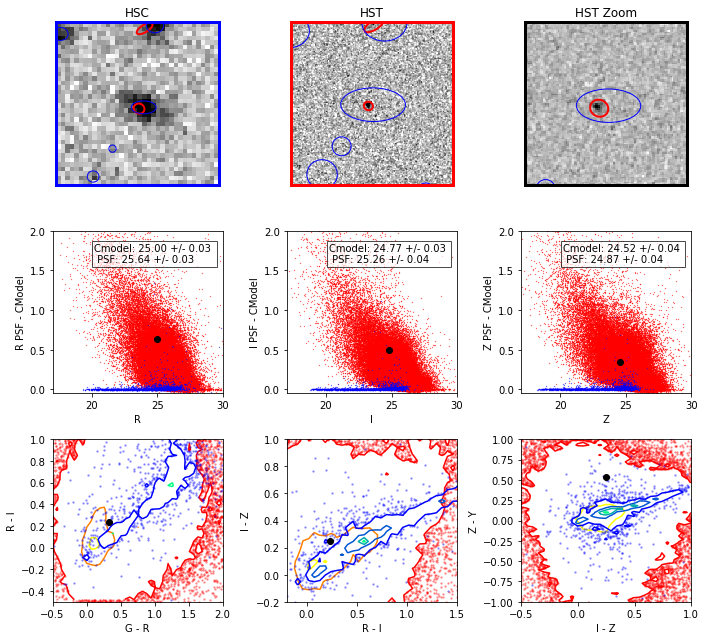

150.714309436 2.06319557717
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_050_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_050_sci.fits



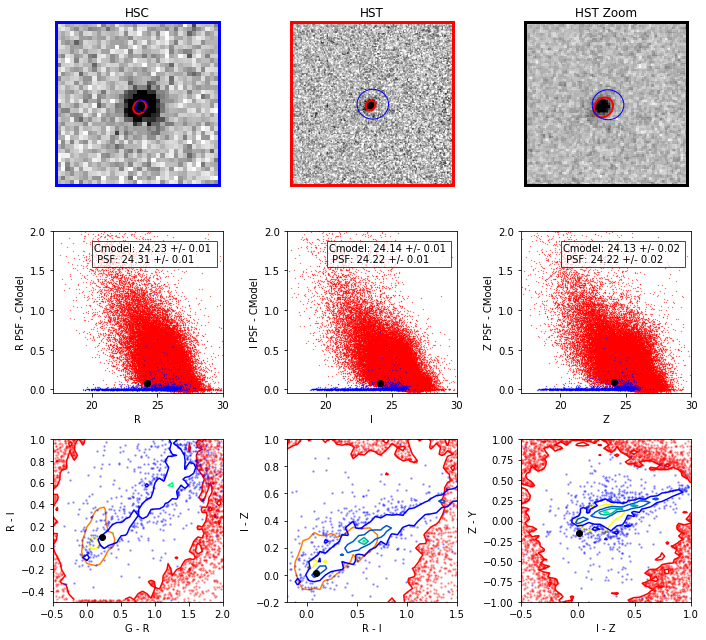

150.299465571 1.63717974529
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_028_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_028_sci.fits



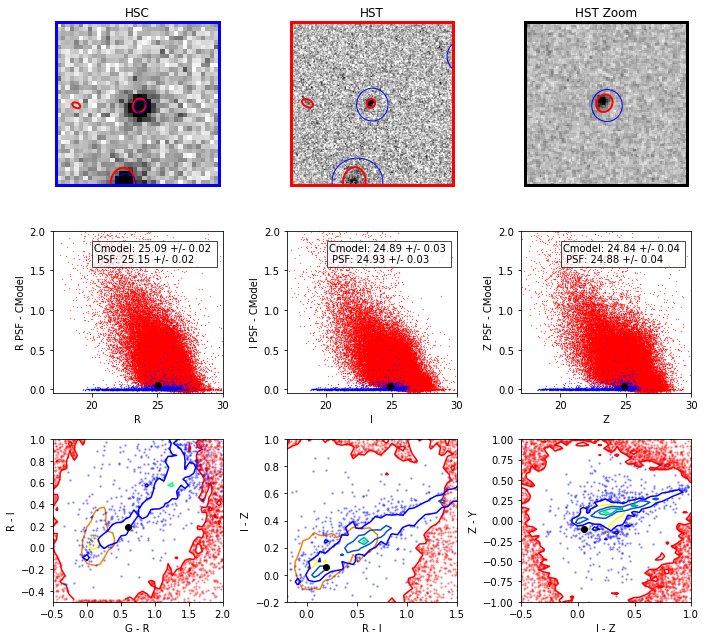

149.881402929 2.13599131045
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_067_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_067_sci.fits



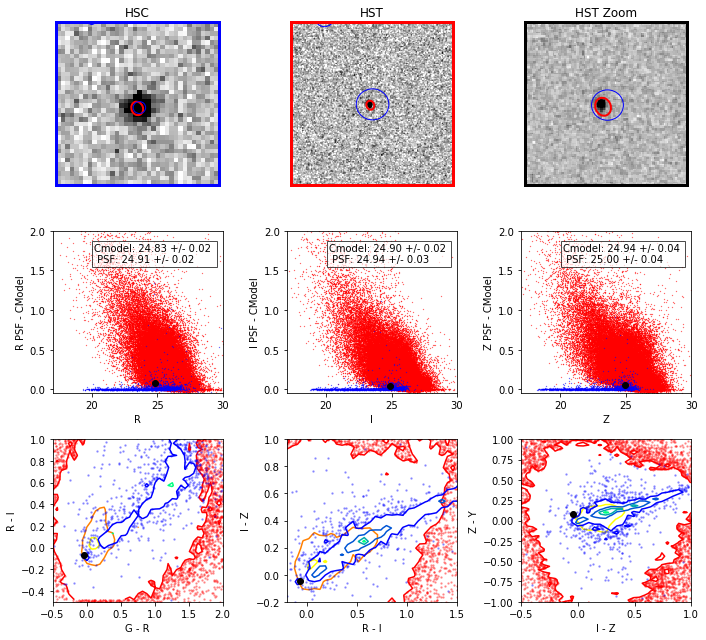

In [20]:
from starGalaxyPlots import hst_hsc_im_comp_plots
sg = "base_ClassificationExtendedness_value_I"


#print(t_hsc.columns)
#sg_sep = t_hsc_match[magPsfCol+"G"][star] - t_hsc_match[magModCol+"G"][star]
sg_ids = np.where((probs[:,0] < sep_prob) & (t_test["CLASS"] == 0) & \
                  (t_test["I"] < 25.0))[0]

print(len(sg_ids))

ras = t_test["RA"][sg_ids]
decs = t_test["DEC"][sg_ids]
patches = t_test["PATCH"][sg_ids]

#for col in t_hsc.columns:
#    if "flag" in col:
#        print(col)
hst_hsc_im_comp_plots(t_test, sg_ids, t_hst, 6.0)

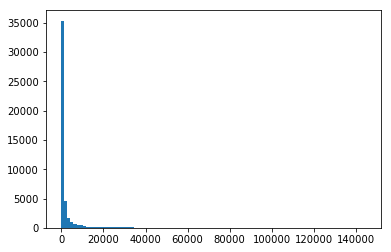

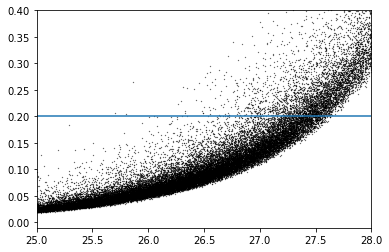

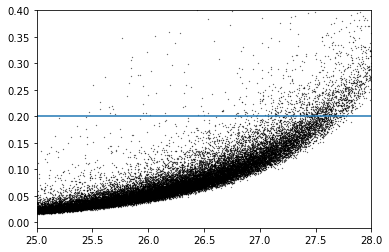

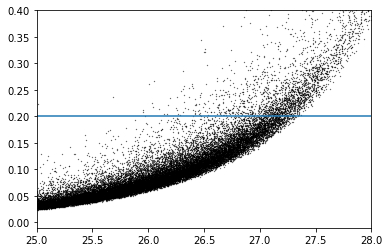

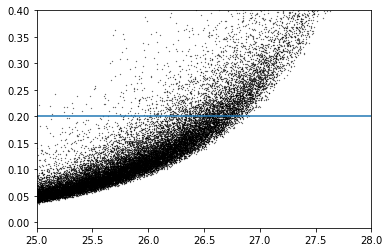

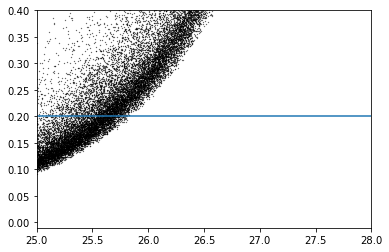

538.444700166


In [21]:
plt.hist(t_info["I"]/t_info["I_ERR"], bins=100)
plt.show()

for band in ["G", "R", "I", "Z", "Y"]:
    plt.plot(t_info[band], t_info[band + "_ERR"], "k.", ms = 0.5)
    plt.ylim(-0.01, 0.4)
    plt.axhline(0.2)
    plt.xlim(25, 28)
    plt.show()

print(np.median(t_info["I"]/t_info["I_ERR"]))

In [25]:
hsc_dir = "/datasets/hsc/repo/rerun/private/nate/shapeTest2/"
dataDetails = {"filter": "HSC-I", "tract": 9813, "patch": "5,5"}
butler = dafPersist.Butler(inputs=hsc_dir)
src = butler.get("deepCoadd_meas", dataId=dataDetails)
print(butler.get("deepCoadd_meas_filename", dataId=dataDetails))
t = Table()       
for col in src.getSchema().getNames():
    t[col] = deepcopy(src[col])
    
exp = butler.get("deepCoadd_calexp", dataId=dataDetails)
calib = exp.getCalib()

modCol = "modelfit_CModel_flux"
modErrCol = "modelfit_CModel_fluxSigma"

ids = np.where((t[modCol] == t[modCol]) & \
              (t[modCol] > 0.0))[0]

flux = np.array(t[modCol]).astype(float)[ids]
fluxErr = t[modErrCol].astype(float)[ids]
mags, magErrs = calib.getMagnitude(flux, fluxErr)


['/datasets/hsc/repo/rerun/private/nate/shapeTest2/deepCoadd-results/HSC-I/9813/5,5/meas-HSC-I-9813-5,5.fits']


/software/lsstsw/stack3_20171023/python/miniconda3-4.3.21/lib/python3.6/site-packages/astropy/table/column.py:928: RuntimeWarning: invalid value encountered in greater
  return getattr(self.data, oper)(other)


In [26]:
hsc_dir = "/datasets/hsc/repo/rerun/private/sreed/coadd5/"
dataDetails = {"filter": "HSC-I", "tract": 9813, "patch": "5,5"}
butler = dafPersist.Butler(inputs=hsc_dir)
src = butler.get("deepCoadd_meas", dataId=dataDetails)

t = Table()       
for col in src.getSchema().getNames():
    t[col] = deepcopy(src[col])
    
exp = butler.get("deepCoadd_calexp", dataId=dataDetails)
calib = exp.getCalib()
print(butler.get("deepCoadd_meas_filename", dataId=dataDetails))
modCol = "modelfit_CModel_flux"
modErrCol = "modelfit_CModel_fluxSigma"

ids = np.where((t[modCol] == t[modCol]) & \
              (t[modCol] > 0.0))[0]

flux = np.array(t[modCol]).astype(float)[ids]
fluxErr = t[modErrCol].astype(float)[ids]
mags5, magErrs5 = calib.getMagnitude(flux, fluxErr)


['/datasets/hsc/repo/rerun/private/sreed/coadd5/deepCoadd-results/HSC-I/9813/5,5/meas-HSC-I-9813-5,5.fits']


/software/lsstsw/stack3_20171023/python/miniconda3-4.3.21/lib/python3.6/site-packages/astropy/table/column.py:928: RuntimeWarning: invalid value encountered in greater
  return getattr(self.data, oper)(other)


In [27]:
hsc_dir = "/datasets/hsc/repo/rerun/private/sreed/coadd10/"
dataDetails = {"filter": "HSC-I", "tract": 9813, "patch": "5,5"}
butler = dafPersist.Butler(inputs=hsc_dir)
src = butler.get("deepCoadd_meas", dataId=dataDetails)

t = Table()       
for col in src.getSchema().getNames():
    t[col] = deepcopy(src[col])
    
exp = butler.get("deepCoadd_calexp", dataId=dataDetails)
calib = exp.getCalib()
print(butler.get("deepCoadd_meas_filename", dataId=dataDetails))
modCol = "modelfit_CModel_flux"
modErrCol = "modelfit_CModel_fluxSigma"

ids = np.where((t[modCol] == t[modCol]) & \
              (t[modCol] > 0.0))[0]

flux = np.array(t[modCol]).astype(float)[ids]
fluxErr = t[modErrCol].astype(float)[ids]
mags10, magErrs10 = calib.getMagnitude(flux, fluxErr)


['/datasets/hsc/repo/rerun/private/sreed/coadd10/deepCoadd-results/HSC-I/9813/5,5/meas-HSC-I-9813-5,5.fits']


/software/lsstsw/stack3_20171023/python/miniconda3-4.3.21/lib/python3.6/site-packages/astropy/table/column.py:928: RuntimeWarning: invalid value encountered in greater
  return getattr(self.data, oper)(other)


In [28]:
hsc_dir = "/datasets/hsc/repo/rerun/private/sreed/coadd20/"
dataDetails = {"filter": "HSC-I", "tract": 9813, "patch": "5,5"}
butler = dafPersist.Butler(inputs=hsc_dir)
src = butler.get("deepCoadd_meas", dataId=dataDetails)

t = Table()       
for col in src.getSchema().getNames():
    t[col] = deepcopy(src[col])
    
exp = butler.get("deepCoadd_calexp", dataId=dataDetails)
calib = exp.getCalib()
print(butler.get("deepCoadd_meas_filename", dataId=dataDetails))
modCol = "modelfit_CModel_flux"
modErrCol = "modelfit_CModel_fluxSigma"

ids = np.where((t[modCol] == t[modCol]) & \
              (t[modCol] > 0.0))[0]

flux = np.array(t[modCol]).astype(float)[ids]
fluxErr = t[modErrCol].astype(float)[ids]
mags20, magErrs20 = calib.getMagnitude(flux, fluxErr)


['/datasets/hsc/repo/rerun/private/sreed/coadd20/deepCoadd-results/HSC-I/9813/5,5/meas-HSC-I-9813-5,5.fits']


/software/lsstsw/stack3_20171023/python/miniconda3-4.3.21/lib/python3.6/site-packages/astropy/table/column.py:928: RuntimeWarning: invalid value encountered in greater
  return getattr(self.data, oper)(other)


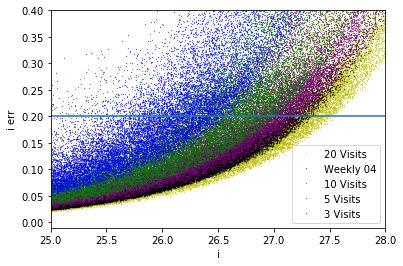

21743 22853


In [35]:
plt.plot(mags20, magErrs20, "y.", ms=0.5, label="20 Visits")
plt.plot(t_info["I"], t_info["I_ERR"], "k.", ms = 0.5, label="Weekly 04")
plt.plot(mags10, magErrs10, ".", ms=0.5, color="purple", label="10 Visits")
plt.plot(mags5, magErrs5, "g.", ms=0.5, label="5 Visits")
plt.plot(mags3, magErrs3, "b.", ms=0.5, label="3 Visits")
plt.ylim(-0.01, 0.4)
plt.axhline(0.2)
plt.xlim(25, 28)
plt.xlabel("i")
plt.ylabel("i err")
plt.legend(loc="best")
#plt.axvline(27.0)
plt.show()

print(len(mags), len(mags3))

In [36]:
print(t.columns)

<TableColumns names=('ext_convolved_ConvolvedFlux_1_3_3_flag_apertureTruncated','ext_convolved_ConvolvedFlux_2_3_3_fluxSigma','ext_convolved_ConvolvedFlux_3_6_0_flag_apertureTruncated','modelfit_CModel_exp_flux','ext_convolved_ConvolvedFlux_0_kron_flag_apCorr','base_SdssCentroid_xSigma','ext_convolved_ConvolvedFlux_2_kron_apCorrSigma','ext_convolved_ConvolvedFlux_2_6_0_flag_sincCoeffsTruncated','modelfit_CModel_initial_apCorr','modelfit_CModel_exp_ellipse_xy','modelfit_CModel_exp_ellipse_xx','ext_convolved_ConvolvedFlux_0_kron_apCorrSigma','ext_convolved_ConvolvedFlux_3_kron_flag_apCorr','base_CircularApertureFlux_25_0_flag','base_CircularApertureFlux_70_0_fluxSigma','ext_convolved_ConvolvedFlux_3_3_3_fluxSigma','base_Blendedness_raw_parent_xy','base_CircularApertureFlux_12_0_fluxSigma','base_Blendedness_abs_flux_parent','ext_convolved_ConvolvedFlux_3_6_0_flag_sincCoeffsTruncated','base_SdssShape_xxSigma','ext_convolved_ConvolvedFlux_1_3_3_apCorrSigma','base_Blendedness_raw_flux_parent